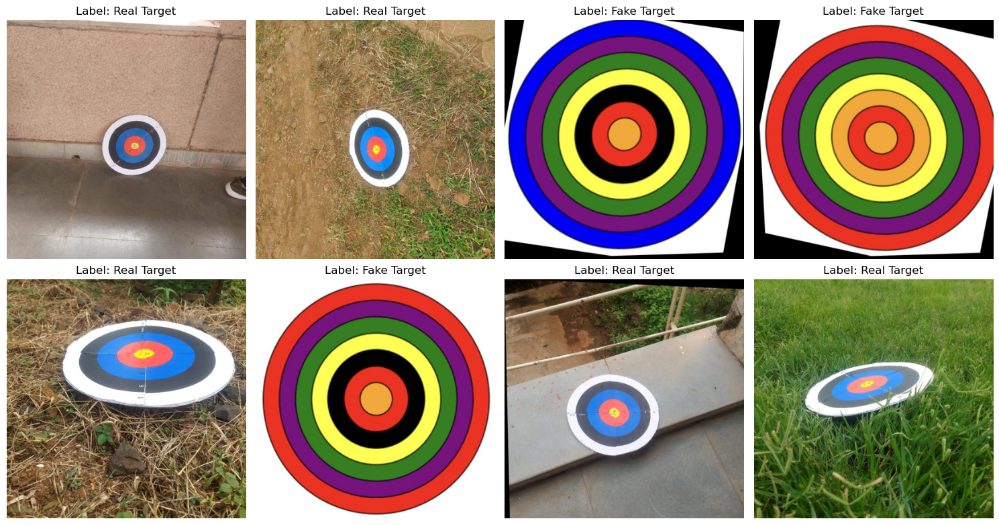

Total images in dataset: 231
Number of real targets (1): 181
Number of fake targets (0): 50


In [1]:

import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Constants
IMG_SIZE = 416
BASE_PATH = '/Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras'

def load_and_display_data(num_images=8):
    """
    Load and preprocess the dataset, and display random images with their labels.

    Args:
        num_images: Number of random images to display (default=8)
    
    Returns:
        images: Array of preprocessed images
        labels: Array of corresponding labels
    """
    images = []
    labels = []
    
    def process_directory(path, label):
        for img_name in os.listdir(path):
            if img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
                img_path = os.path.join(path, img_name)
                img = Image.open(img_path).convert("RGB")
                img = img.resize((IMG_SIZE, IMG_SIZE))
                img_array = np.array(img) / 255.0  # Normalize
                images.append(img_array)
                labels.append(label)
    
    # Process fake targets (class 0)
    fake_path = os.path.join(BASE_PATH, '0')
    process_directory(fake_path, 0)
    
    # Process real targets (class 1)
    real_path = os.path.join(BASE_PATH, '1')
    process_directory(real_path, 1)
    
    images = np.array(images, dtype=np.float32)
    labels = np.array(labels, dtype=np.int32)
    
    # Display random images
    fig = plt.figure(figsize=(15, 8))
    indices = np.random.randint(0, len(images), num_images)
    
    for idx, i in enumerate(indices):
        ax = fig.add_subplot(2, 4, idx + 1)
        ax.imshow(images[i])
        label_text = "Real Target" if labels[i] == 1 else "Fake Target"
        ax.set_title(f"Label: {label_text}")
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    print(f"Total images in dataset: {len(images)}")
    print(f"Number of real targets (1): {np.sum(labels)}")
    print(f"Number of fake targets (0): {len(labels) - np.sum(labels)}")
    
    return images, labels

# Call the combined function
X, y = load_and_display_data()

In [2]:
import cv2
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from sklearn.model_selection import train_test_split

# Function to create a bounding box detection model
def create_bbox_detection_model():
    """
    Create a model that outputs both classification and bounding box coordinates
    """
    base_model = tf.keras.applications.MobileNetV2(
        input_shape=(IMG_SIZE, IMG_SIZE, 3),
        include_top=False,
        weights='imagenet'
    )
    
    # Freeze the base model
    base_model.trainable = False
    
    # Add custom layers
    x = base_model.output
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(512, activation='relu')(x)
    x = layers.Dropout(0.3)(x)
    
    # Classification output
    class_output = layers.Dense(1, activation='sigmoid', name='class_output')(x)
    
    # Bounding box output (x, y, width, height)
    bbox_output = layers.Dense(4, activation='sigmoid', name='bbox_output')(x)
    
    # Create the model
    model = tf.keras.Model(inputs=base_model.input, outputs=[class_output, bbox_output])
    
    return model


In [3]:

# Create training data with bounding boxes
def create_bbox_training_data():
    """
    Create training data with bounding boxes
    """
    images = []
    class_labels = []
    bbox_labels = []
    
    def process_directory(path, class_label):
        for img_name in os.listdir(path):
            if img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
                img_path = os.path.join(path, img_name)
                img = Image.open(img_path).convert("RGB")
                
                # Get original dimensions
                width, height = img.size
                
                # Resize image
                img = img.resize((IMG_SIZE, IMG_SIZE))
                img_array = np.array(img) / 255.0  # Normalize
                
                # Generate bounding box
                # For simplicity, we're assuming the target is roughly in the center
                # In a real-world scenario, you would need actual bounding box annotations
                
                # Create a simulated bounding box (normalized to [0,1])
                # This is a placeholder - in practice, you'd use actual labeled bbox data
                center_x = 0.5 + np.random.normal(0, 0.05)  # Center with some variation
                center_y = 0.5 + np.random.normal(0, 0.05)
                box_width = 0.4 + np.random.normal(0, 0.1)  # Random width around 0.4
                box_height = 0.4 + np.random.normal(0, 0.1)  # Random height around 0.4
                
                # Make sure values are within [0,1]
                center_x = max(0, min(1, center_x))
                center_y = max(0, min(1, center_y))
                box_width = max(0.1, min(0.8, box_width))
                box_height = max(0.1, min(0.8, box_height))
                
                # For fake targets, we'll make the bounding box less confident by adding more noise
                if class_label == 0:  # Fake target
                    center_x = 0.5 + np.random.normal(0, 0.15)
                    center_y = 0.5 + np.random.normal(0, 0.15)
                    box_width = 0.3 + np.random.normal(0, 0.2)  # More variation
                    box_height = 0.3 + np.random.normal(0, 0.2)
                    
                    # Make sure values are within [0,1]
                    center_x = max(0, min(1, center_x))
                    center_y = max(0, min(1, center_y))
                    box_width = max(0.1, min(0.8, box_width))
                    box_height = max(0.1, min(0.8, box_height))
                
                images.append(img_array)
                class_labels.append(class_label)
                bbox_labels.append([center_x, center_y, box_width, box_height])
    
    # Process fake targets (class 0)
    fake_path = os.path.join(BASE_PATH, '0')
    process_directory(fake_path, 0)
    
    # Process real targets (class 1)
    real_path = os.path.join(BASE_PATH, '1')
    process_directory(real_path, 1)
    
    return np.array(images), np.array(class_labels), np.array(bbox_labels)

# Function to train the bounding box model
def train_bbox_model():
    """
    Train the bounding box detection model
    """
    # Get training data with bounding boxes
    X, y_class, y_bbox = create_bbox_training_data()
    
    # Split data
    X_train, X_test, y_class_train, y_class_test, y_bbox_train, y_bbox_test = train_test_split(
        X, y_class, y_bbox, test_size=0.2, random_state=42
    )
    
    # Create and compile the model
    model = create_bbox_detection_model()
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
        loss={
            'class_output': 'binary_crossentropy',
            'bbox_output': 'mse'
        },
        metrics={
            'class_output': 'accuracy',
            'bbox_output': 'mse'
        }
    )
    
    # Train the model
    history = model.fit(
        X_train,
        {'class_output': y_class_train, 'bbox_output': y_bbox_train},
        validation_data=(X_test, {'class_output': y_class_test, 'bbox_output': y_bbox_test}),
        epochs=5,
        batch_size=32
    )
    
    return model, history, X_test, y_class_test, y_bbox_test


In [4]:

# Function to predict class and bounding box
def predict_with_bbox(model, image_path):
    """
    Predict class and bounding box for a single image
    """
    img = Image.open(image_path).convert("RGB")
    original_img = np.array(img)
    
    # Resize for model input
    img = img.resize((IMG_SIZE, IMG_SIZE))
    img_array = np.array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    
    # Get predictions
    class_pred, bbox_pred = model.predict(img_array)
    
    # Extract prediction values
    is_real = class_pred[0][0] > 0.5
    label = "Real Target" if is_real else "Fake Target"
    confidence = class_pred[0][0] if is_real else 1 - class_pred[0][0]
    
    # Extract bounding box coordinates (center_x, center_y, width, height)
    center_x, center_y, width, height = bbox_pred[0]
    
    # Convert to corner coordinates
    x1 = center_x - width/2
    y1 = center_y - height/2
    x2 = center_x + width/2
    y2 = center_y + height/2
    
    # Plot the image with bounding box
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    
    # Create a Rectangle patch
    rect_color = 'green' if is_real else 'red'
    rect = patches.Rectangle(
        (x1 * IMG_SIZE, y1 * IMG_SIZE),
        width * IMG_SIZE,
        height * IMG_SIZE,
        linewidth=2,
        edgecolor=rect_color,
        facecolor='none'
    )
    
    # Add the patch to the Axes
    plt.gca().add_patch(rect)
    
    plt.title(f"Prediction: {label}\nConfidence: {confidence:.2%}")
    plt.axis('off')
    plt.show()
    
    return label, confidence, (x1, y1, x2, y2)

# Function to process a directory of images
def process_directory_with_bbox(model, directory_path):
    """
    Process all images in a directory and draw bounding boxes
    """
    for img_name in os.listdir(directory_path):
        if img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
            img_path = os.path.join(directory_path, img_name)
            print(f"Processing {img_name}...")
            predict_with_bbox(model, img_path)

# Function to evaluate the bounding box model
def evaluate_bbox_model(model, X_test, y_class_test, y_bbox_test):
    """
    Evaluate the bounding box detection model
    """
    results = model.evaluate(
        X_test,
        {'class_output': y_class_test, 'bbox_output': y_bbox_test}
    )
    
    print("Test results:")
    print(f"Loss: {results[0]:.4f}")
    print(f"Classification loss: {results[1]:.4f}")
    print(f"Bounding box loss: {results[2]:.4f}")
    print(f"Classification accuracy: {results[3]:.4f}")
    print(f"Bounding box MSE: {results[4]:.4f}")

# Use OpenCV to draw bounding boxes on the original image
def draw_bbox_on_image(image_path, bbox, is_real):
    """
    Draw bounding box on an image using OpenCV
    """
    img = cv2.imread(image_path)
    h, w, _ = img.shape
    
    # Unpack bbox (normalized values)
    x1, y1, x2, y2 = bbox
    
    # Convert normalized coordinates to pixel values
    x1 = int(x1 * w)
    y1 = int(y1 * h)
    x2 = int(x2 * w)
    y2 = int(y2 * h)
    
    # Draw rectangle
    color = (0, 255, 0) if is_real else (0, 0, 255)  # Green for real, Red for fake
    cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
    
    # Add label
    label = "Real Target" if is_real else "Fake Target"
    cv2.putText(img, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
    
    # Display the image
    cv2.imshow('Detection', img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    
    # Save the image with bounding box
    output_path = image_path.replace('.jpg', '_bbox.jpg').replace('.png', '_bbox.png')
    cv2.imwrite(output_path, img)
    print(f"Saved image with bounding box to {output_path}")

# Main function to run the bounding box detection pipeline
def run_bbox_detection_pipeline():
    """
    Main function to run the entire bounding box detection pipeline
    """
    print("Training bounding box detection model...")
    model, history, X_test, y_class_test, y_bbox_test = train_bbox_model()
    
    print("Evaluating model...")
    evaluate_bbox_model(model, X_test, y_class_test, y_bbox_test)
    
    print("Saving model...")
    model.save('target_detection_bbox_model.h5')
    
    print("Testing on sample images...")
    test_dir = os.path.join(BASE_PATH, 'test_images')
    if os.path.exists(test_dir):
        process_directory_with_bbox(model, test_dir)
    else:
        print(f"Test directory {test_dir} not found. Please create it and add test images.")


In [5]:
def analyze_model_fit(history, model, X_test, y_class_test, y_bbox_test):
    """
    Analyze if the model is overfitting or underfitting by comparing training and validation metrics.
    
    Args:
        history: Training history object
        model: Trained model
        X_test: Test images
        y_class_test: Test classification labels
        y_bbox_test: Test bounding box coordinates
    """
    # Evaluate on test set
    print("\n=== Model Fit Analysis ===")
    test_results = model.evaluate(
        X_test,
        {'class_output': y_class_test, 'bbox_output': y_bbox_test},
        verbose=0
    )
    
    # Extract final training metrics from history
    final_train_class_acc = history.history['class_output_accuracy'][-1]
    final_val_class_acc = history.history['val_class_output_accuracy'][-1]
    final_train_bbox_loss = history.history['bbox_output_loss'][-1]
    final_val_bbox_loss = history.history['val_bbox_output_loss'][-1]
    
    # Print comparison table
    print("\nAccuracy and Loss Comparison:")
    print("-" * 60)
    print(f"{'Metric':<20} | {'Training':<10} | {'Validation':<10} | {'Test':<10}")
    print("-" * 60)
    print(f"{'Classification Acc':<20} | {final_train_class_acc:.4f} | {final_val_class_acc:.4f} | {test_results[3]:.4f}")
    print(f"{'Bounding Box Loss':<20} | {final_train_bbox_loss:.4f} | {final_val_bbox_loss:.4f} | {test_results[2]:.4f}")
    print("-" * 60)
    
    # Analyze overfitting/underfitting
    class_diff = abs(final_train_class_acc - final_val_class_acc)
    bbox_diff = abs(final_train_bbox_loss - final_val_bbox_loss)
    
    print("\nModel Fit Analysis:")
    
    # Classification analysis
    if final_train_class_acc < 0.65:
        print("Classification: Model might be UNDERFITTING - both training and validation accuracy are low.")
    elif class_diff > 0.1 and final_train_class_acc > final_val_class_acc:
        print("Classification: Model shows signs of OVERFITTING - training accuracy is significantly higher than validation.")
    else:
        print("Classification: Model seems to be FITTING WELL - similar performance on training and validation sets.")
    
    # Bounding box analysis
    if final_train_bbox_loss > 0.1:
        print("Bounding Box: Model might be UNDERFITTING - training loss is relatively high.")
    elif bbox_diff > 0.05 and final_train_bbox_loss < final_val_bbox_loss:
        print("Bounding Box: Model shows signs of OVERFITTING - training loss is significantly lower than validation.")
    else:
        print("Bounding Box: Model seems to be FITTING WELL - similar losses on training and validation sets.")
    
    # Visualize training history
    plt.figure(figsize=(15, 10))
    
    # Plot classification accuracy
    plt.subplot(2, 2, 1)
    plt.plot(history.history['class_output_accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_class_output_accuracy'], label='Validation Accuracy')
    plt.title('Classification Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Plot classification loss
    plt.subplot(2, 2, 2)
    plt.plot(history.history['class_output_loss'], label='Training Loss')
    plt.plot(history.history['val_class_output_loss'], label='Validation Loss')
    plt.title('Classification Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Plot bounding box loss
    plt.subplot(2, 2, 3)
    plt.plot(history.history['bbox_output_loss'], label='Training Loss')
    plt.plot(history.history['val_bbox_output_loss'], label='Validation Loss')
    plt.title('Bounding Box Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Plot overall loss
    plt.subplot(2, 2, 4)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Total Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.show()
    
    # Provide recommendations based on analysis
    print("\nRecommendations:")
    if final_train_class_acc < 0.65 or final_train_bbox_loss > 0.1:
        print("- Consider using a more complex model or fine-tuning more layers")
        print("- Train for more epochs")
        print("- Try different hyperparameters like learning rate or optimizer")
    elif (class_diff > 0.1 and final_train_class_acc > final_val_class_acc) or (bbox_diff > 0.05 and final_train_bbox_loss < final_val_bbox_loss):
        print("- Add dropout layers or increase dropout rate")
        print("- Use regularization (L1 or L2)")
        print("- Implement early stopping")
        print("- Try data augmentation to increase effective training set size")
    else:
        print("- Model is performing well, consider deploying it")
        print("- You may try fine-tuning to potentially improve performance slightly")

# Update the run_bbox_detection_pipeline function to include the analysis
def run_bbox_detection_pipeline():
    """
    Main function to run the entire bounding box detection pipeline
    """
    print("Training bounding box detection model...")
    model, history, X_test, y_class_test, y_bbox_test = train_bbox_model()
    
    print("Evaluating model...")
    evaluate_bbox_model(model, X_test, y_class_test, y_bbox_test)
    
    print("Analyzing model fit...")
    analyze_model_fit(history, model, X_test, y_class_test, y_bbox_test)
    
    print("Saving model...")
    model.save('target_detection_bbox_model.h5')
    
    print("Testing on sample images...")
    test_dir = os.path.join(BASE_PATH, 'test_images')
    if os.path.exists(test_dir):
        process_directory_with_bbox(model, test_dir)
    else:
        print(f"Test directory {test_dir} not found. Please create it and add test images.")

# If you want to run the analysis separately on an existing model and history
def analyze_existing_model(model_path, history_path, X_test, y_class_test, y_bbox_test):
    """
    Analyze an existing model without retraining
    
    Args:
        model_path: Path to saved model
        history_path: Path to saved history object
        X_test: Test images
        y_class_test: Test classification labels
        y_bbox_test: Test bounding box coordinates
    """
    import pickle
    
    # Load model and history
    model = tf.keras.models.load_model(model_path)
    with open(history_path, 'rb') as f:
        history = pickle.load(f)
    
    # Run analysis
    analyze_model_fit(history, model, X_test, y_class_test, y_bbox_test)

Training bounding box detection model...


Epoch 1/5
6/6 [==============================] - 14s 2s/step - loss: 0.1688 - class_output_loss: 0.1325 - bbox_output_loss: 0.0364 - class_output_accuracy: 0.9239 - bbox_output_mse: 0.0364 - val_loss: 0.0156 - val_class_output_loss: 3.1022e-04 - val_bbox_output_loss: 0.0153 - val_class_output_accuracy: 1.0000 - val_bbox_output_mse: 0.0153
Epoch 2/5
6/6 [==============================] - 14s 2s/step - loss: 0.0354 - class_output_loss: 2.2202e-04 - bbox_output_loss: 0.0352 - class_output_accuracy: 1.0000 - bbox_output_mse: 0.0352 - val_loss: 0.0206 - val_class_output_loss: 5.5001e-05 - val_bbox_output_loss: 0.0205 - val_class_output_accuracy: 1.0000 - val_bbox_output_mse: 0.0205
Epoch 3/5
6/6 [==============================] - 14s 2s/step - loss: 0.0386 - class_output_loss: 4.4465e-05 - bbox_output_loss: 0.0385 - class_output_accuracy: 1.0000 - bbox_output_mse: 0.0385 - val_loss: 0.0174 - val_class_output_loss: 3.4287e-05 - val_bbox_output_loss: 0.0173 - val_class_output_accuracy: 1.0000

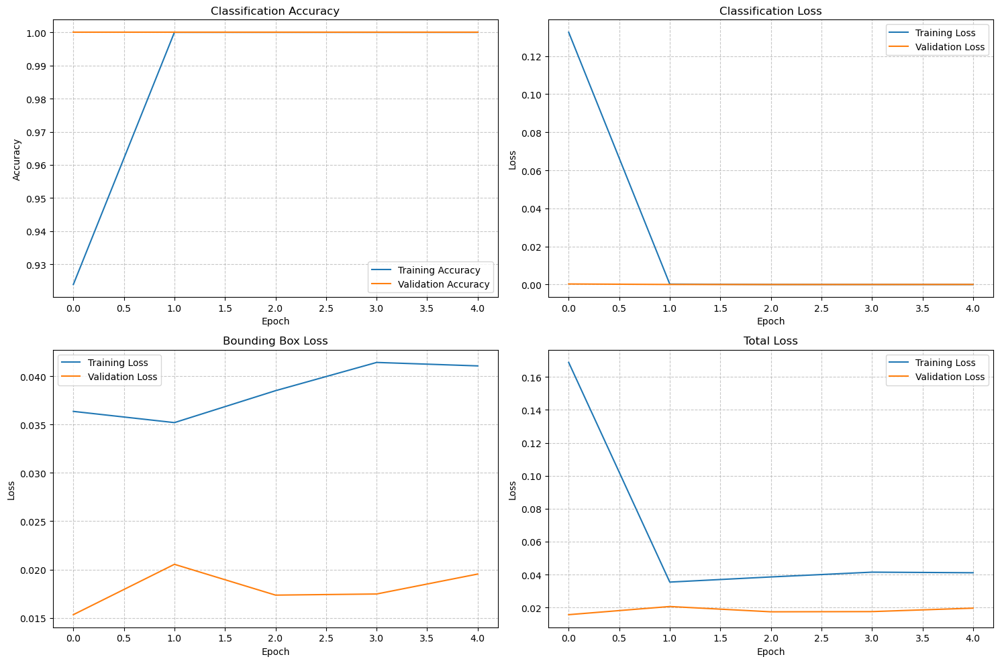


Recommendations:
- Model is performing well, consider deploying it
- You may try fine-tuning to potentially improve performance slightly
Saving model...


/Users/rohanshenoy/anaconda3/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Testing on sample images...
Processing 22-5474-m_png_jpg.rf.e0eecd628edb43f145976ec18d1a581f.jpg...
1/1 [==============================] - 0s 462ms/step


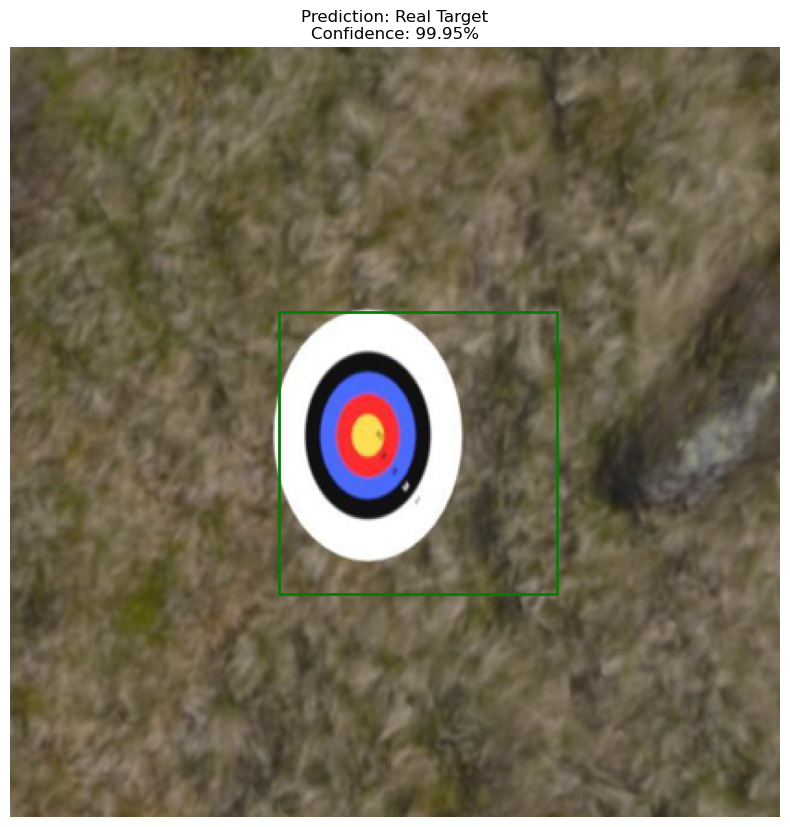

Processing WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.acc9ee2419b47491d9b75f9642be0672.jpg...
1/1 [==============================] - 0s 64ms/step


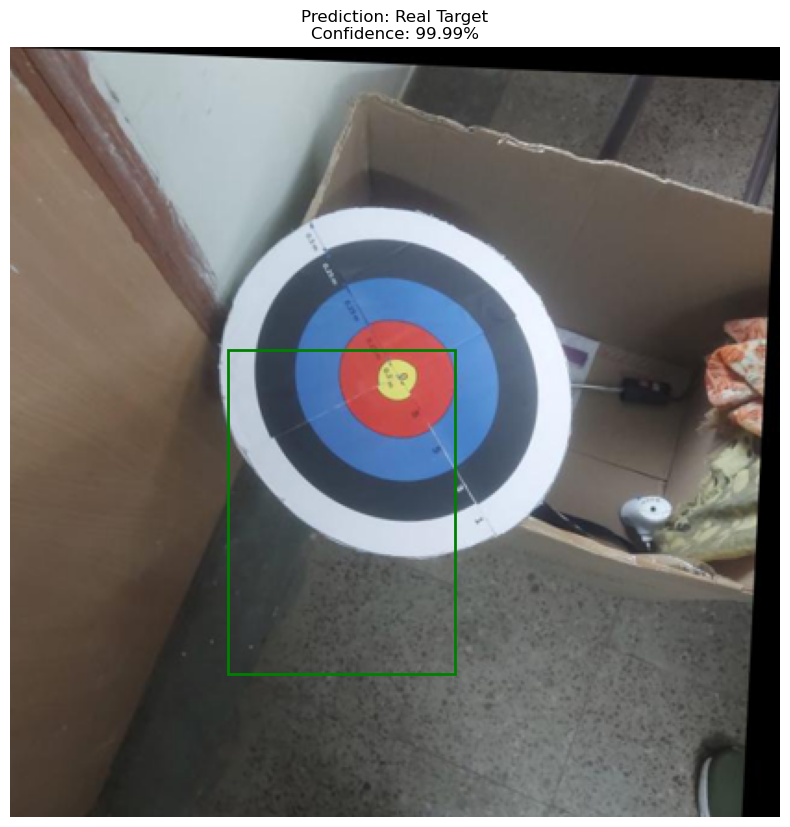

Processing Screenshot 2025-01-21 at 7.31.14 PM copy.png...
1/1 [==============================] - 0s 50ms/step


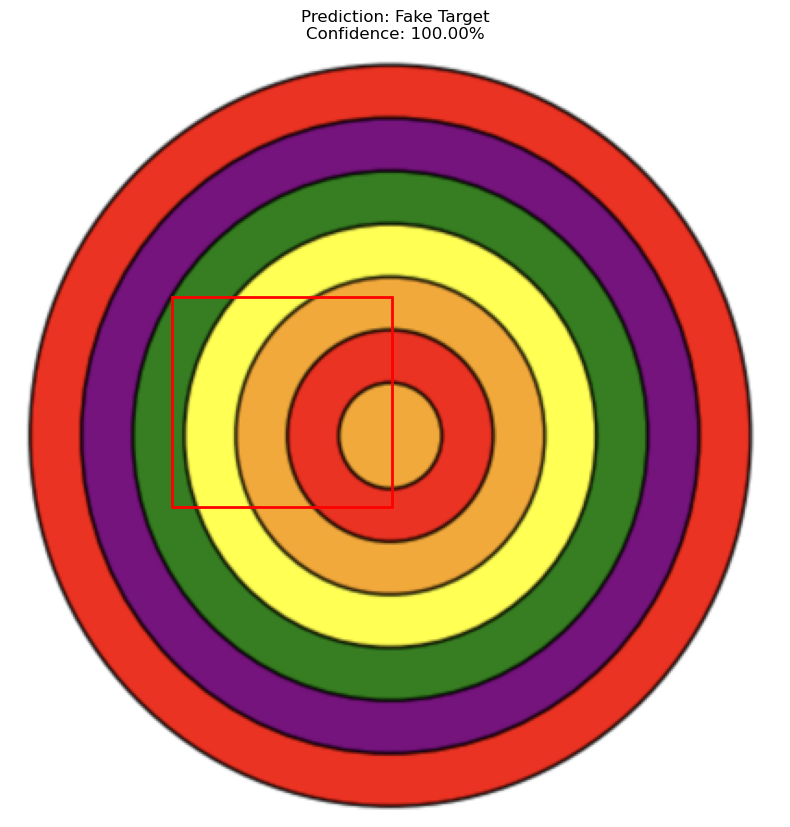

Processing 8-17775-m_png_jpg.rf.3f11632d50c507feec6906a1aa0f0822.jpg...
1/1 [==============================] - 0s 71ms/step


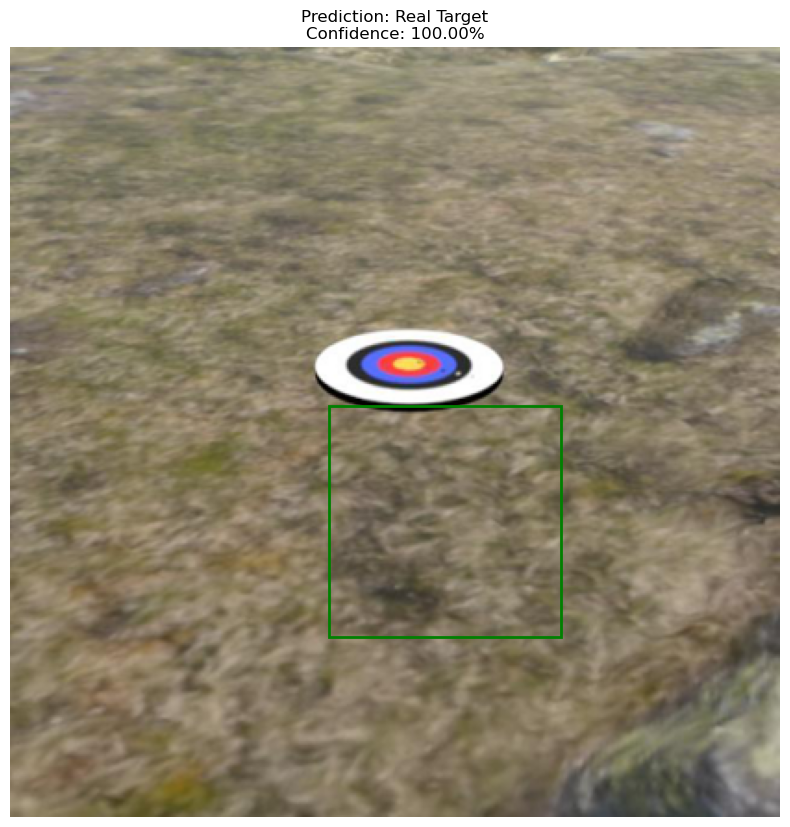

Processing Screenshot 2025-01-21 at 7.17.57 PM.png...
1/1 [==============================] - 0s 52ms/step


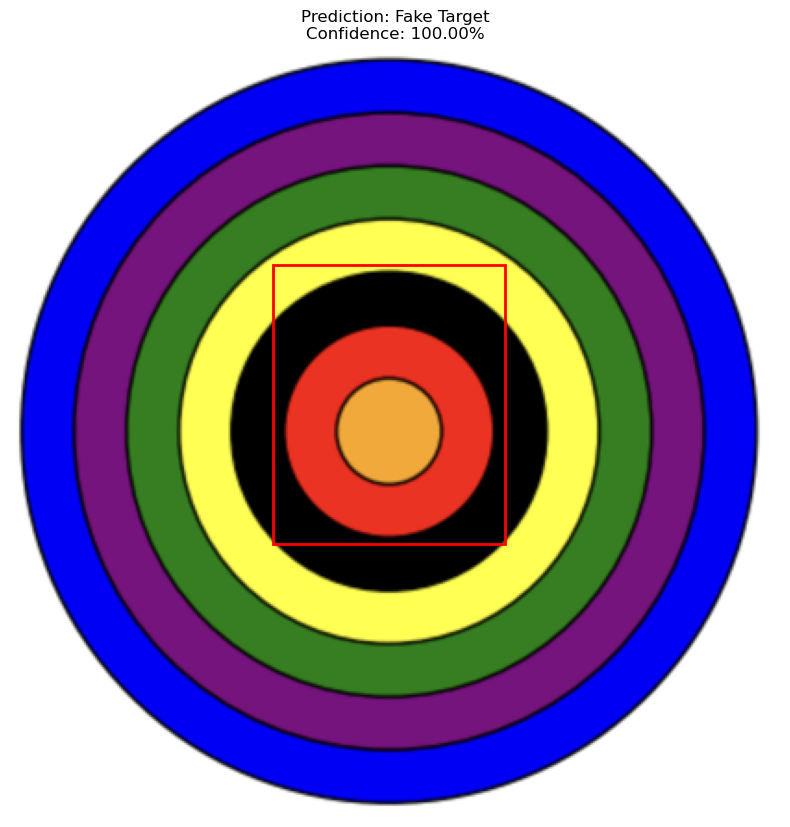

Processing 33-3255-m_png_jpg.rf.5503a8dac27e5972020846d85d2c7f0f.jpg...
1/1 [==============================] - 0s 65ms/step


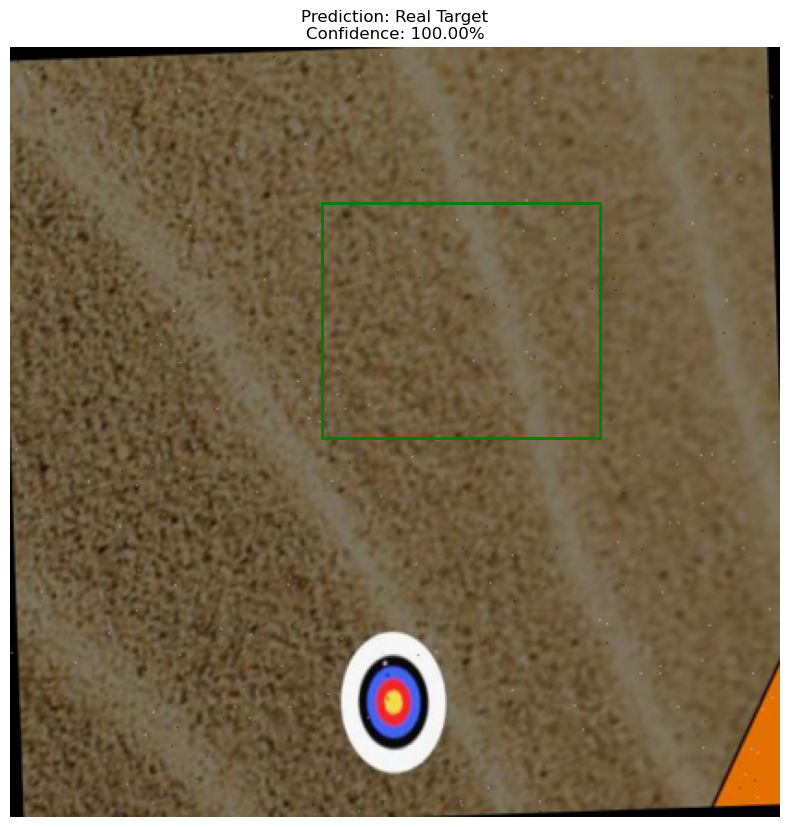

Processing Screenshot 2025-01-21 at 7.31.14 PM copy 3.png...
1/1 [==============================] - 0s 53ms/step


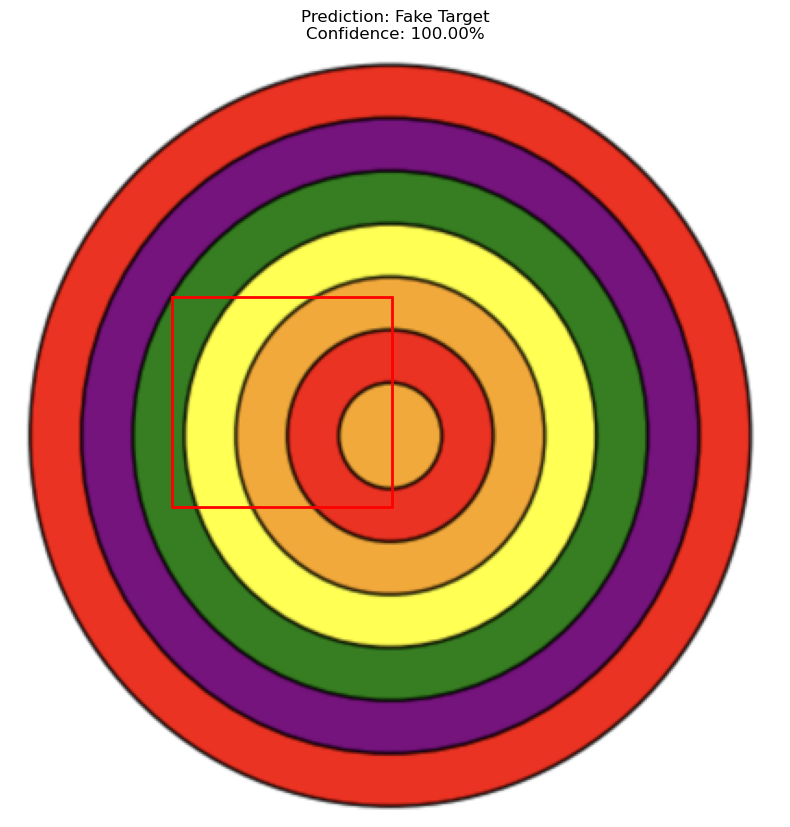

Processing Screenshot 2025-01-21 at 7.31.14 PM copy 2.png...
1/1 [==============================] - 0s 66ms/step


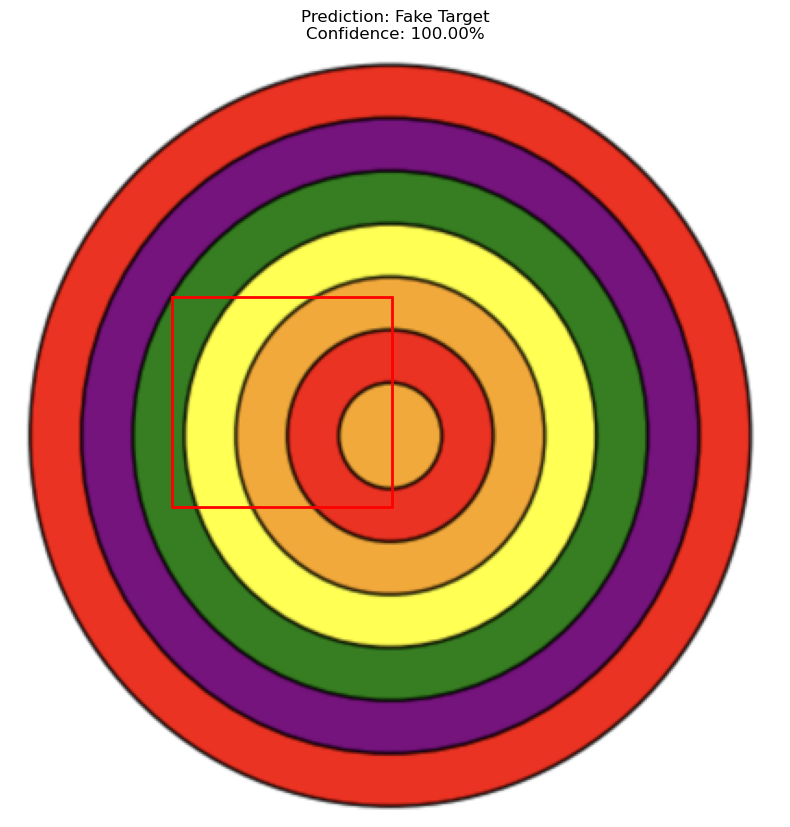

Processing Screenshot 2025-01-21 at 7.16.19 PM copy.png...
1/1 [==============================] - 0s 58ms/step


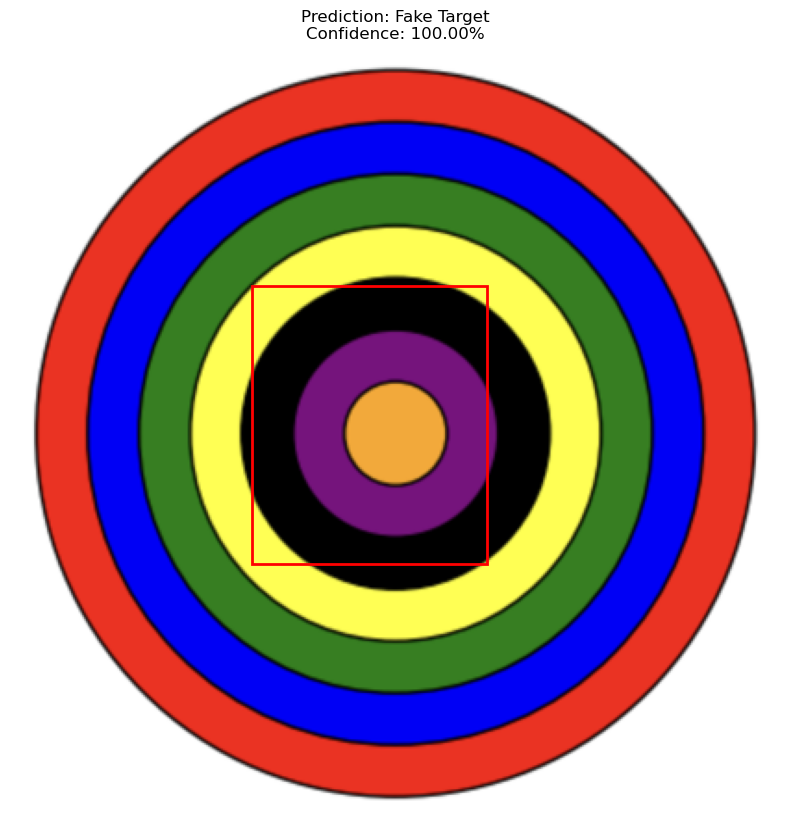

Processing Screenshot 2025-01-21 at 7.17.57 PM copy.png...
1/1 [==============================] - 0s 64ms/step


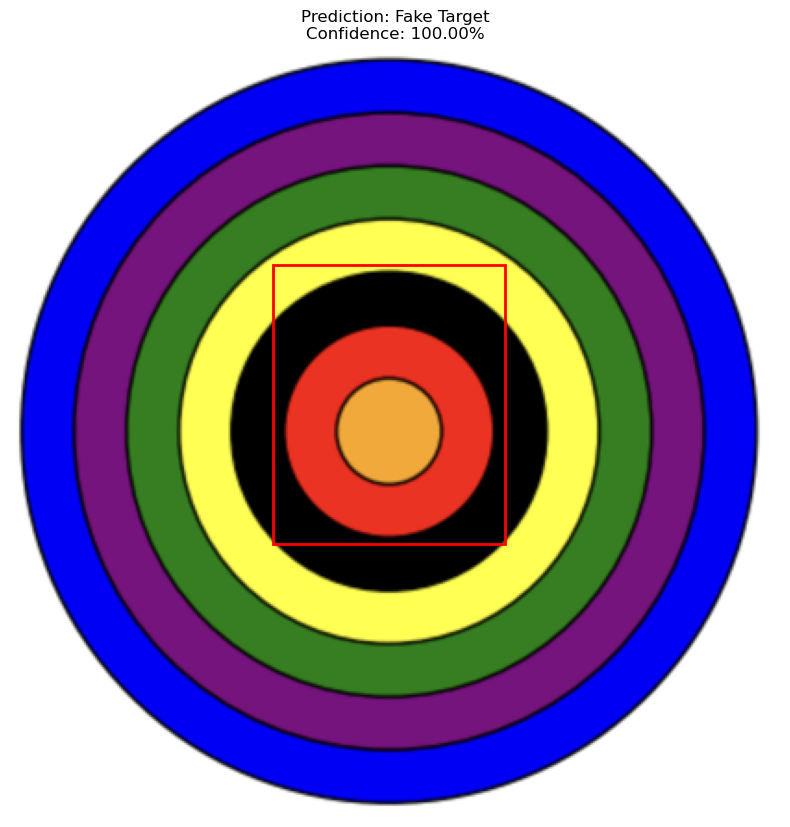

Processing WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.049457a1dafd55f5cb52c3625926adef.jpg...
1/1 [==============================] - 0s 64ms/step


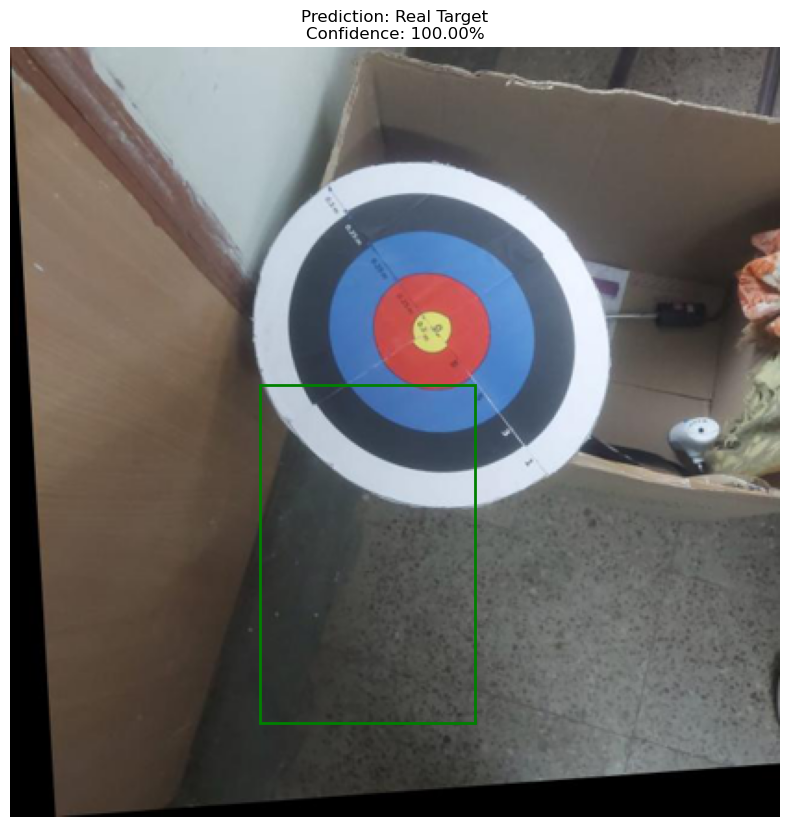

Processing Screenshot 2025-01-21 at 7.16.19 PM.png...
1/1 [==============================] - 0s 51ms/step


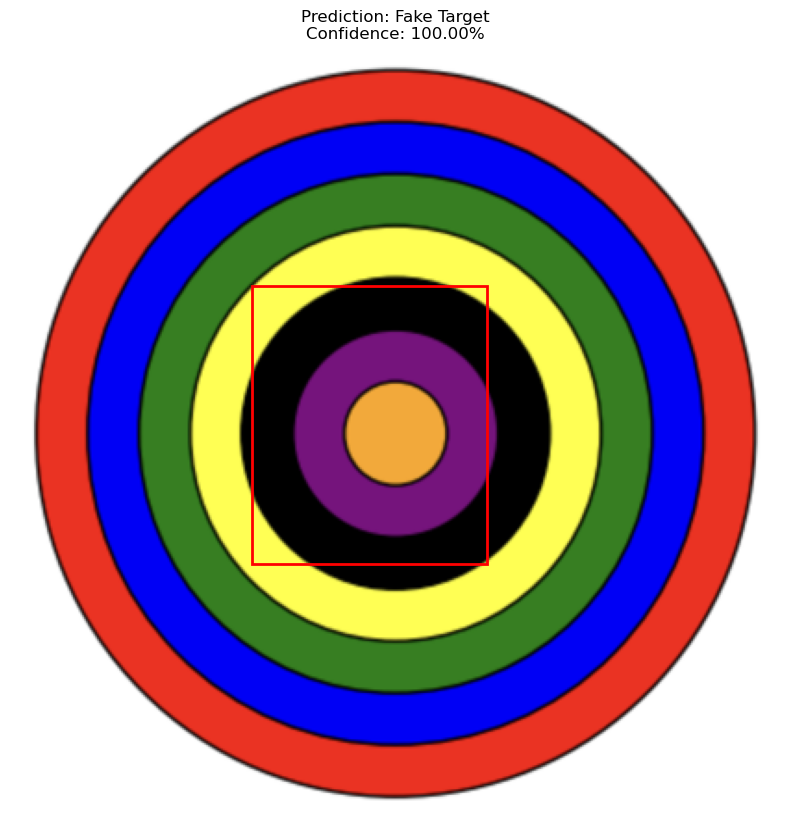

Processing 16-7489-m_png_jpg.rf.55aa9bdf517024d6a5dd23722f86b731.jpg...
1/1 [==============================] - 0s 61ms/step


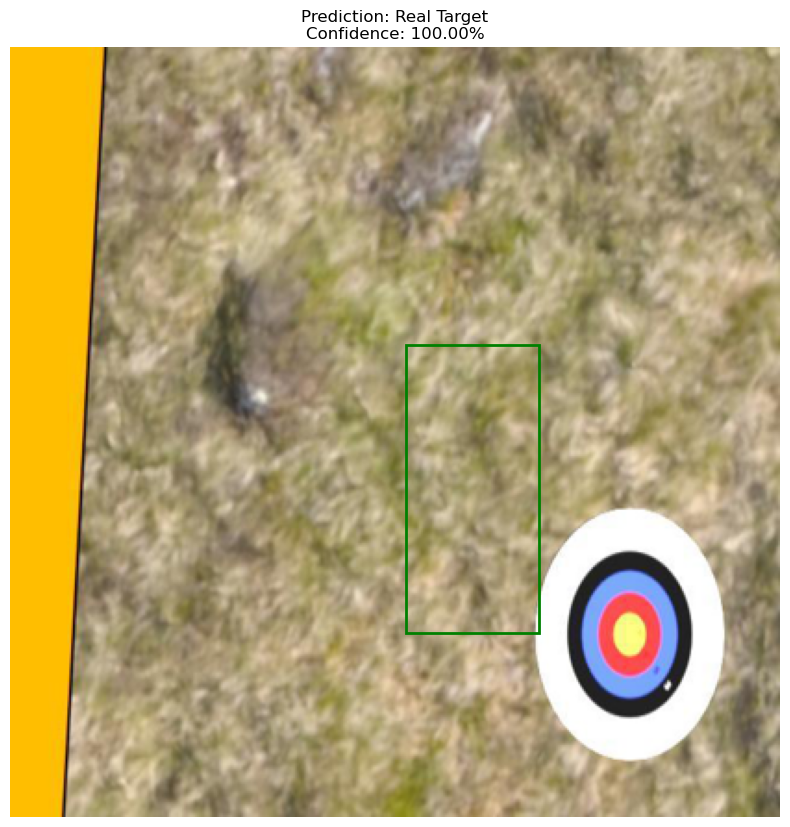

Processing 24-7637-m_png_jpg.rf.b1a8c5a9beedc18fd5cac1d9bd6fc2c8.jpg...
1/1 [==============================] - 0s 54ms/step


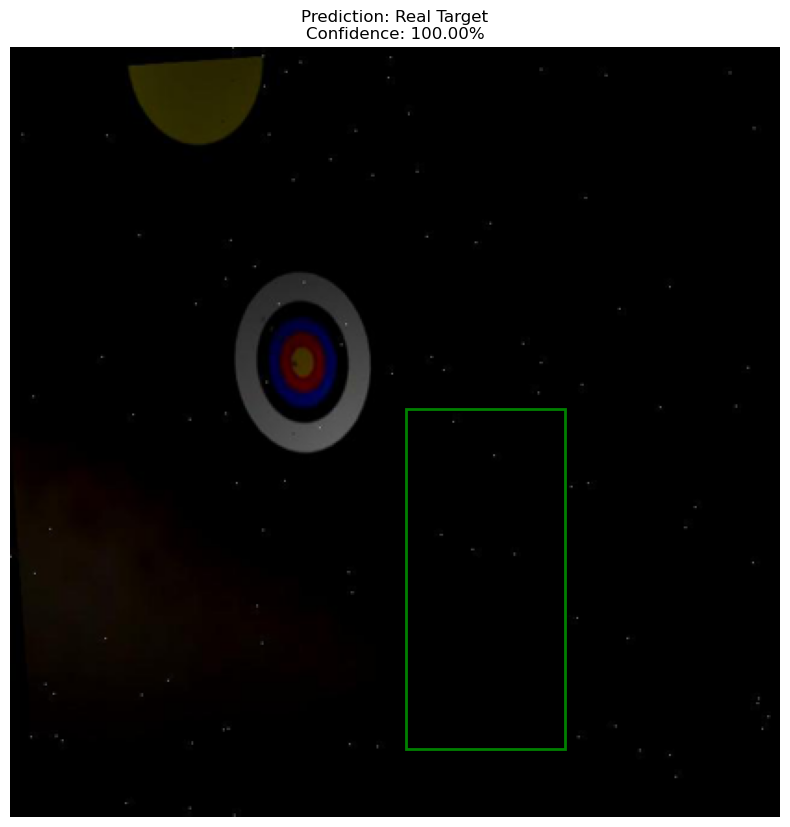

Processing Screenshot 2025-01-21 at 7.16.19 PM copy 2.png...
1/1 [==============================] - 0s 58ms/step


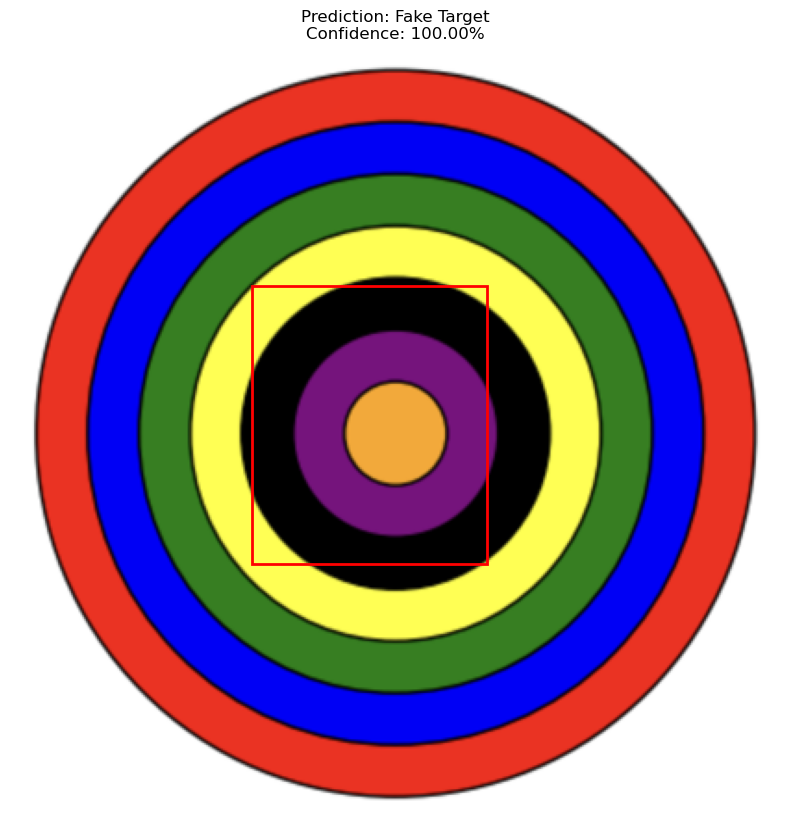

Processing 26-1887-m_png_jpg.rf.53bf0c66ffcb0e832d11135026cc0862.jpg...
1/1 [==============================] - 0s 63ms/step


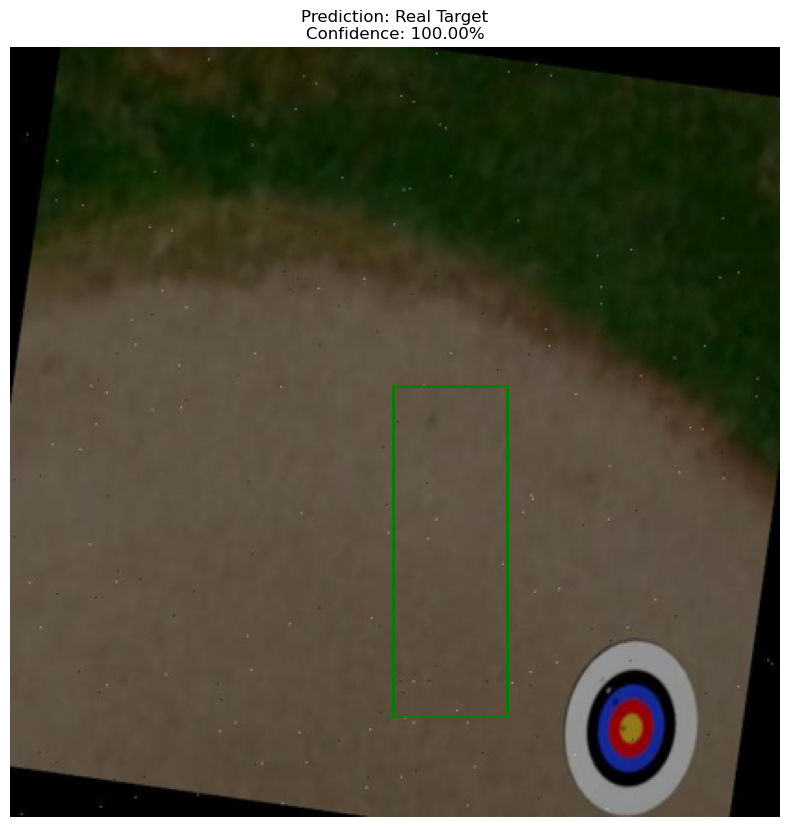

Processing WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.e83b8e4fef41131304ab4de65bf911ce.jpg...
1/1 [==============================] - 0s 47ms/step


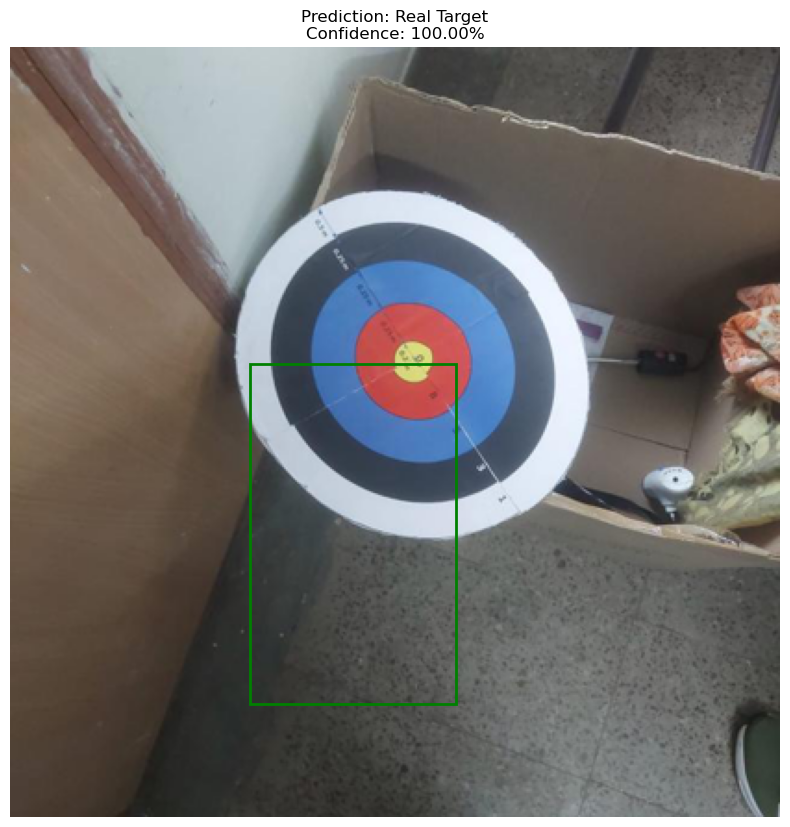

Processing 32-443-m_png_jpg.rf.985846371218c907dc2433fe3fb79c1c.jpg...
1/1 [==============================] - 0s 49ms/step


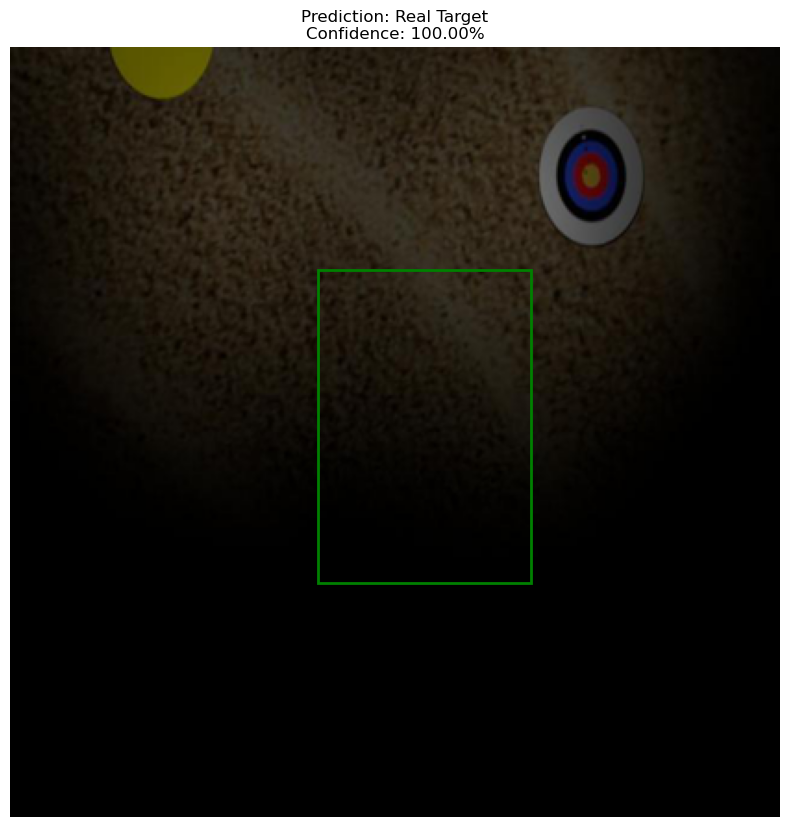

Processing Screenshot 2025-01-21 at 7.17.57 PM copy 2.png...
1/1 [==============================] - 0s 51ms/step


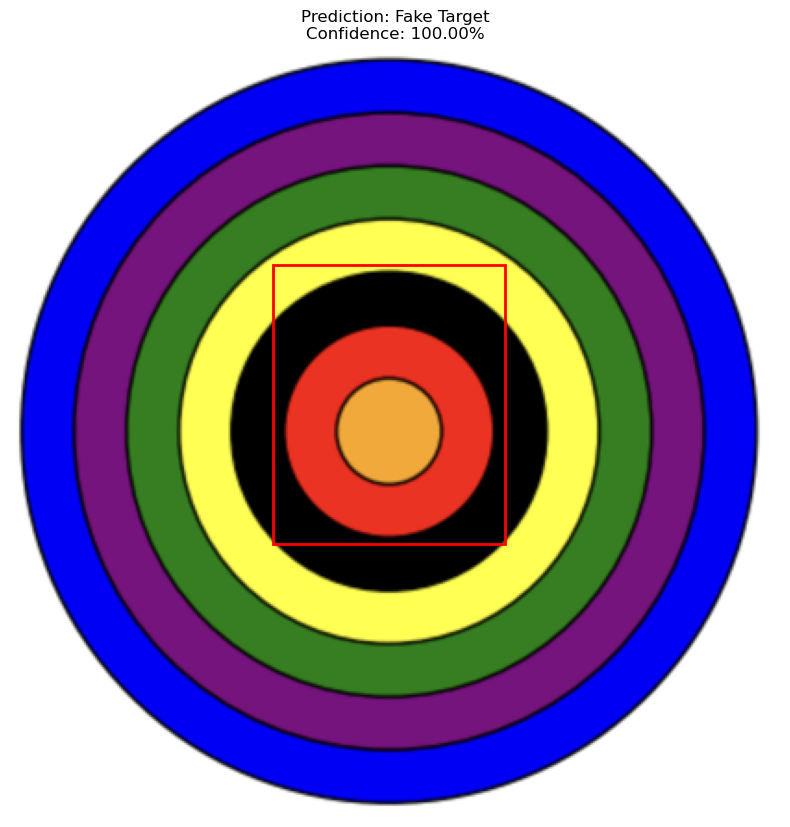

Processing 33-3255-m_png_jpg.rf.4f3269f33ea1d9a809a7ef3bff504a01.jpg...
1/1 [==============================] - 0s 61ms/step


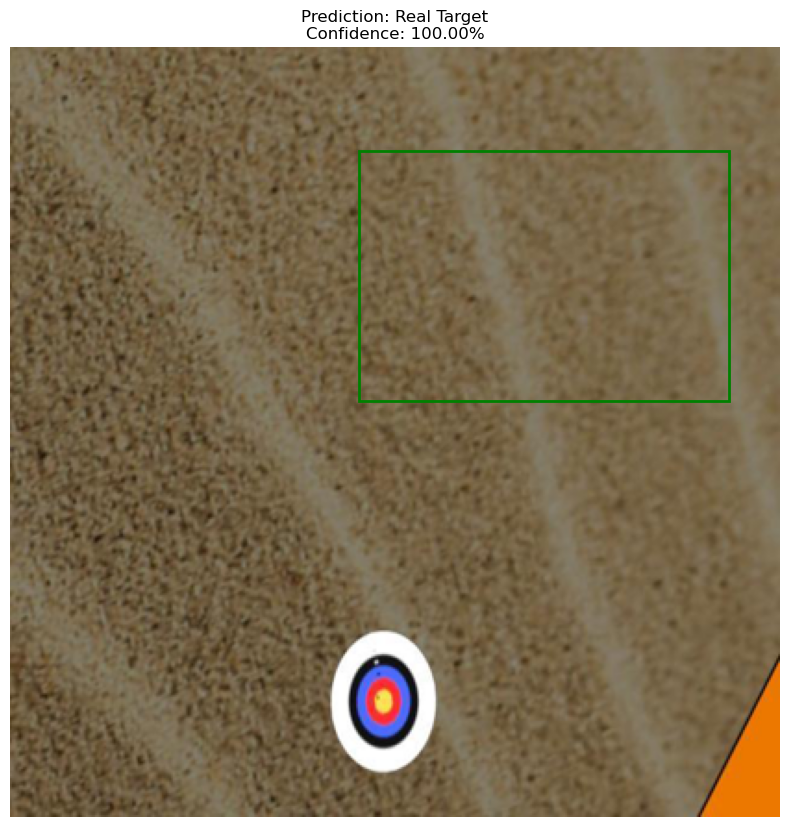


==== Analysis Complete ====


In [6]:
# Add this at the end of your script to ensure the analysis runs

# This part should be at the bottom of your script, after all your function definitions
if __name__ == "__main__":
    # Train the bounding box model
    print("Training bounding box detection model...")
    model, history, X_test, y_class_test, y_bbox_test = train_bbox_model()
    
    print("Evaluating model...")
    evaluate_bbox_model(model, X_test, y_class_test, y_bbox_test)
    
    print("Analyzing model fit...")
    analyze_model_fit(history, model, X_test, y_class_test, y_bbox_test)
    
    print("Saving model...")
    model.save('target_detection_bbox_model.h5')
    
    # Save history for future analysis
    import pickle
    with open('training_history.pkl', 'wb') as f:
        pickle.dump(history, f)
    
    print("Testing on sample images...")
    test_dir = os.path.join(BASE_PATH, 'test_images')
    if os.path.exists(test_dir):
        process_directory_with_bbox(model, test_dir)
    else:
        print(f"Test directory {test_dir} not found. Please create it and add test images.")
        
    print("\n==== Analysis Complete ====")

Training bounding box detection model...


Epoch 1/5
6/6 [==============================] - 15s 2s/step - loss: 0.1965 - class_output_loss: 0.1623 - bbox_output_loss: 0.0342 - class_output_accuracy: 0.9239 - bbox_output_mse: 0.0342 - val_loss: 0.0171 - val_class_output_loss: 0.0017 - val_bbox_output_loss: 0.0154 - val_class_output_accuracy: 1.0000 - val_bbox_output_mse: 0.0154
Epoch 2/5
6/6 [==============================] - 11s 2s/step - loss: 0.0362 - class_output_loss: 8.9834e-04 - bbox_output_loss: 0.0353 - class_output_accuracy: 1.0000 - bbox_output_mse: 0.0353 - val_loss: 0.0165 - val_class_output_loss: 0.0014 - val_bbox_output_loss: 0.0151 - val_class_output_accuracy: 1.0000 - val_bbox_output_mse: 0.0151
Epoch 3/5
6/6 [==============================] - 11s 2s/step - loss: 0.0402 - class_output_loss: 4.1165e-04 - bbox_output_loss: 0.0398 - class_output_accuracy: 1.0000 - bbox_output_mse: 0.0398 - val_loss: 0.0186 - val_class_output_loss: 0.0013 - val_bbox_output_loss: 0.0173 - val_class_output_accuracy: 1.0000 - val_bbox_

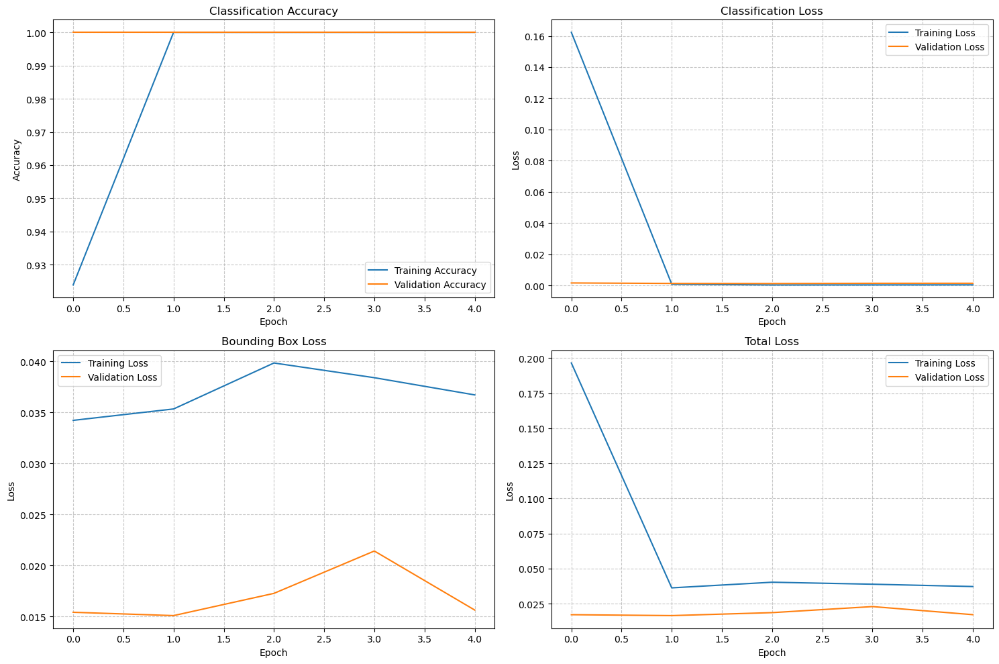


Recommendations:
- Model is performing well, consider deploying it
- You may try fine-tuning to potentially improve performance slightly
Saving model...
Testing on sample images...
Processing 22-5474-m_png_jpg.rf.e0eecd628edb43f145976ec18d1a581f.jpg...
1/1 [==============================] - 0s 480ms/step


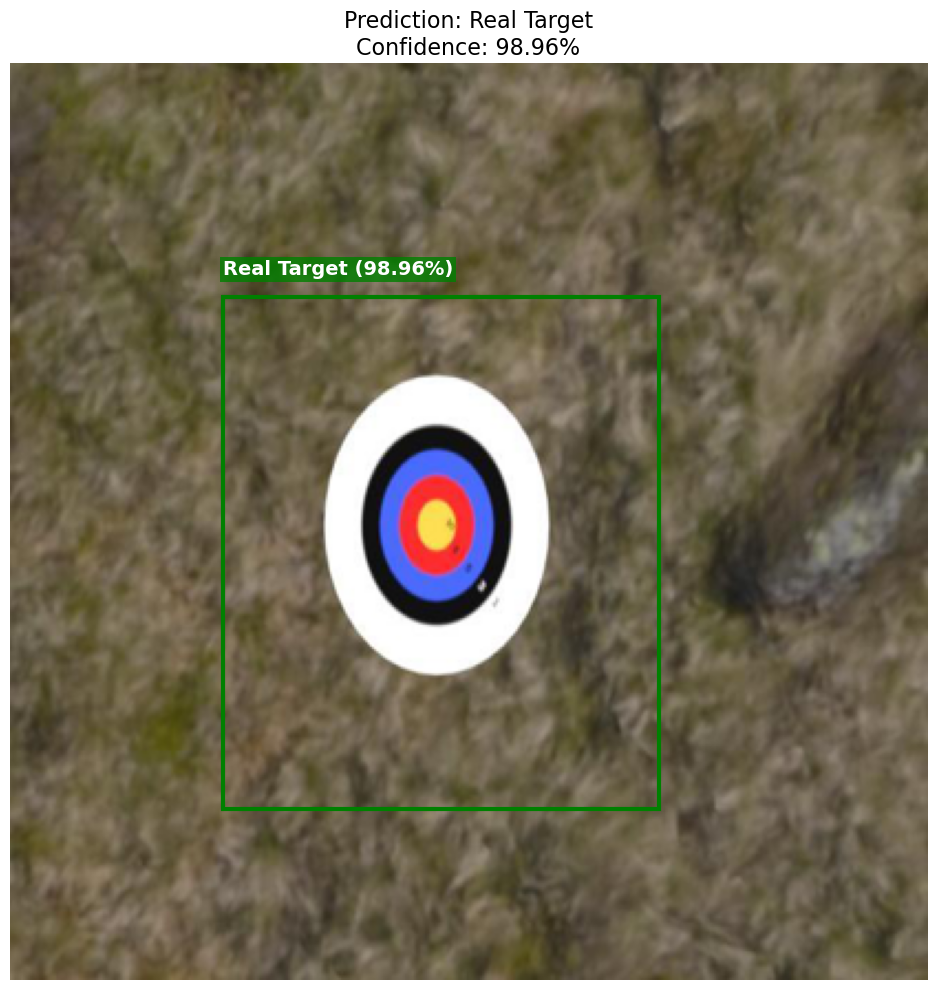

2025-03-18 23:35:05.211 python[87573:29723849] +[IMKClient subclass]: chose IMKClient_Modern
2025-03-18 23:35:05.211 python[87573:29723849] +[IMKInputSession subclass]: chose IMKInputSession_Modern


Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_22-5474-m_png_jpg.rf.e0eecd628edb43f145976ec18d1a581f.jpg
Processing WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.acc9ee2419b47491d9b75f9642be0672.jpg...
1/1 [==============================] - 0s 77ms/step


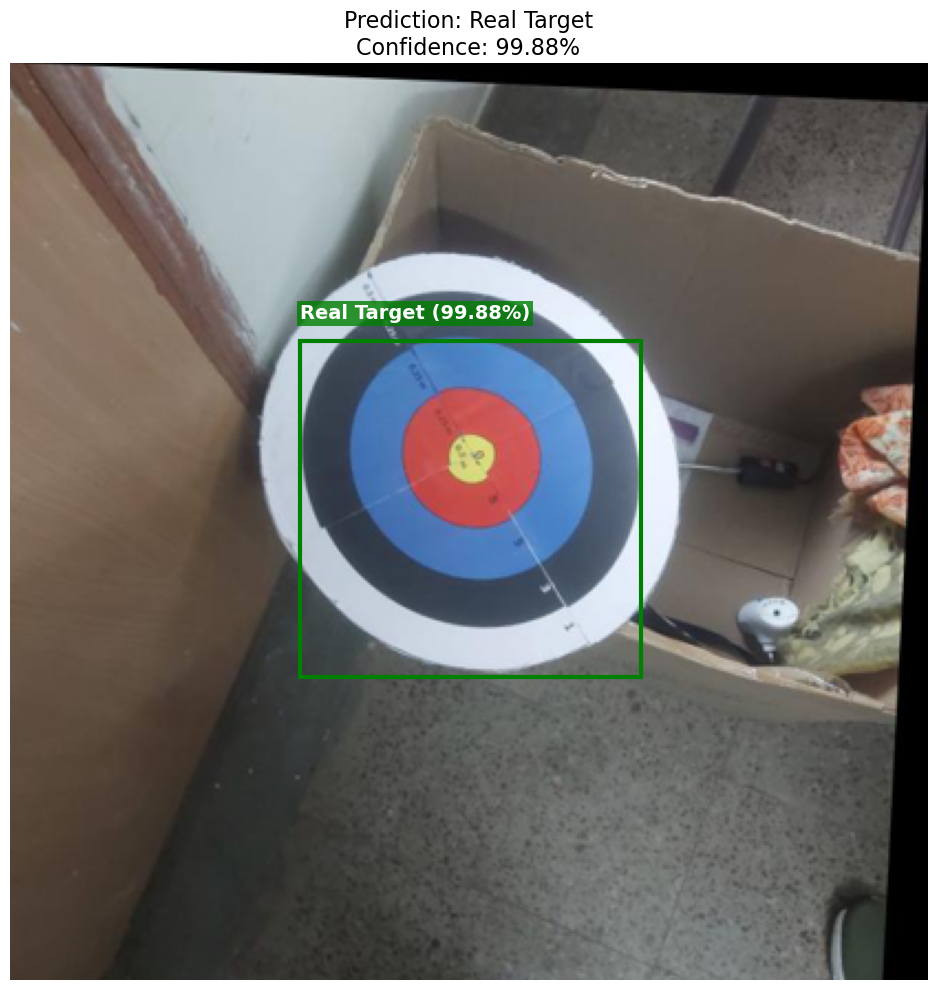

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.acc9ee2419b47491d9b75f9642be0672.jpg
Processing Screenshot 2025-01-21 at 7.31.14 PM copy.png...
1/1 [==============================] - 0s 64ms/step


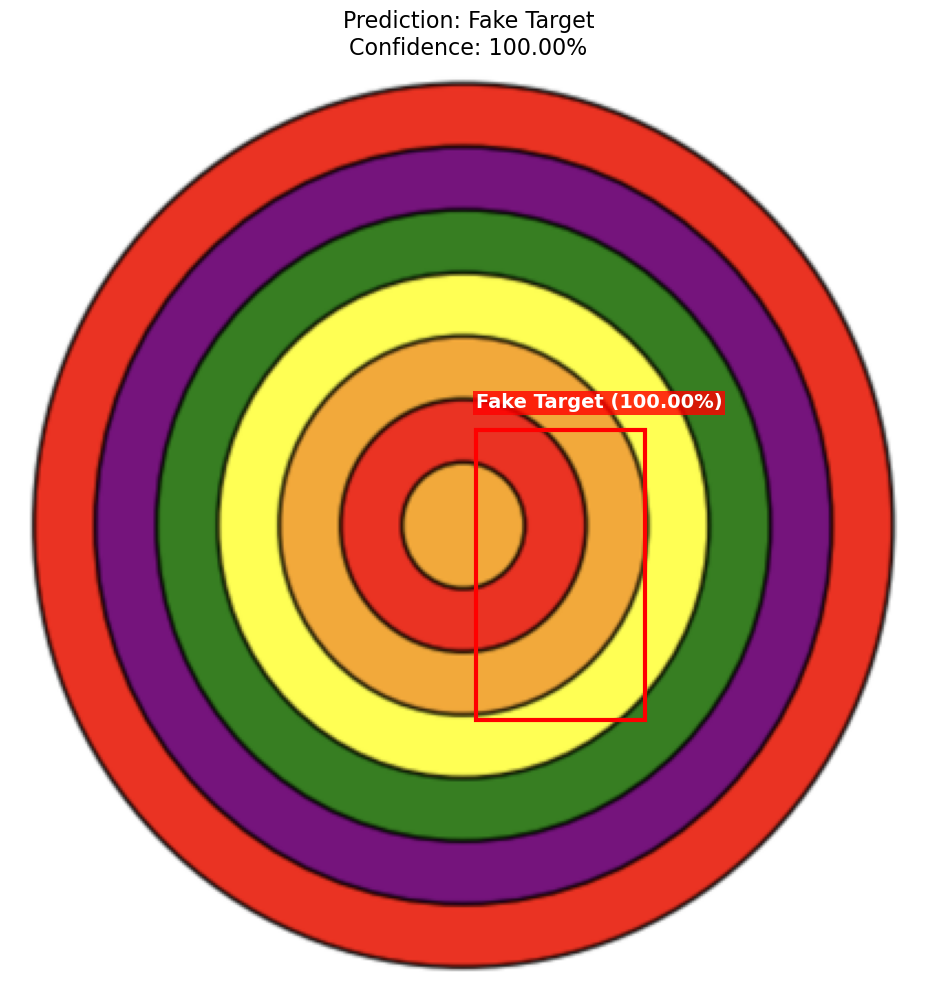

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.31.14 PM copy.png
Processing 8-17775-m_png_jpg.rf.3f11632d50c507feec6906a1aa0f0822.jpg...
1/1 [==============================] - 0s 58ms/step


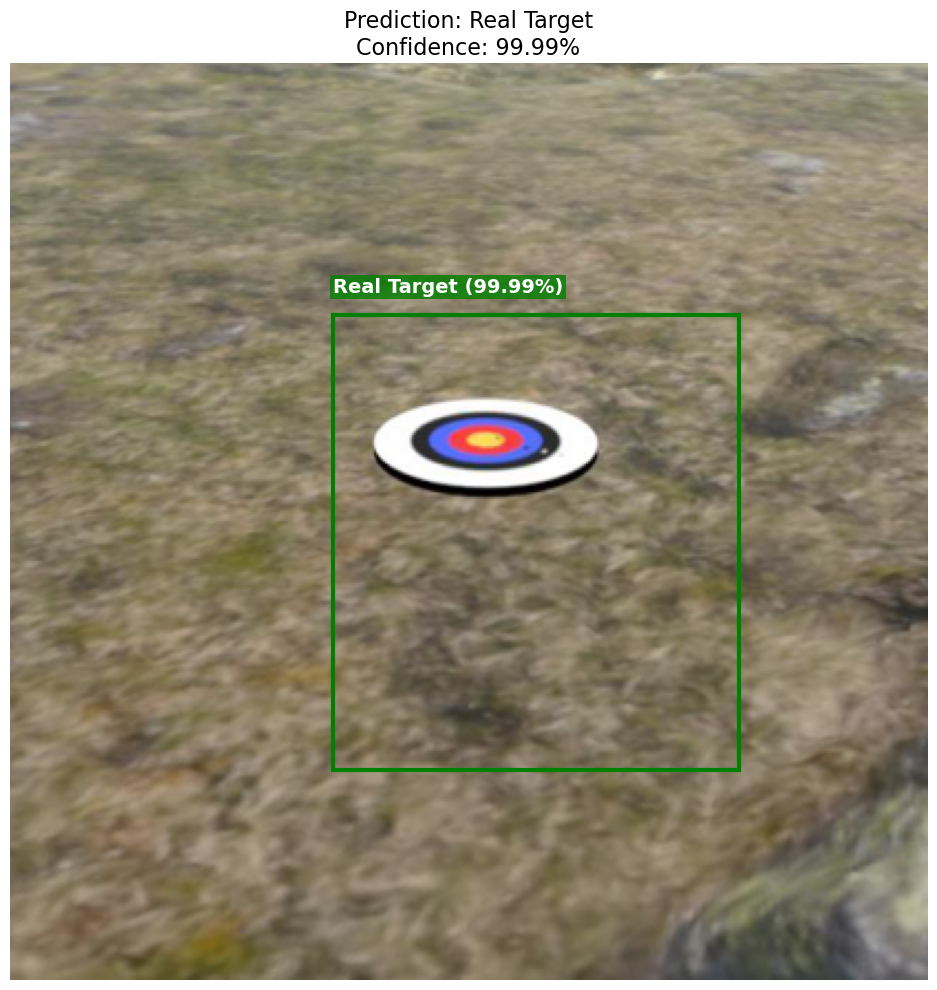

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_8-17775-m_png_jpg.rf.3f11632d50c507feec6906a1aa0f0822.jpg
Processing Screenshot 2025-01-21 at 7.17.57 PM.png...
1/1 [==============================] - 0s 52ms/step


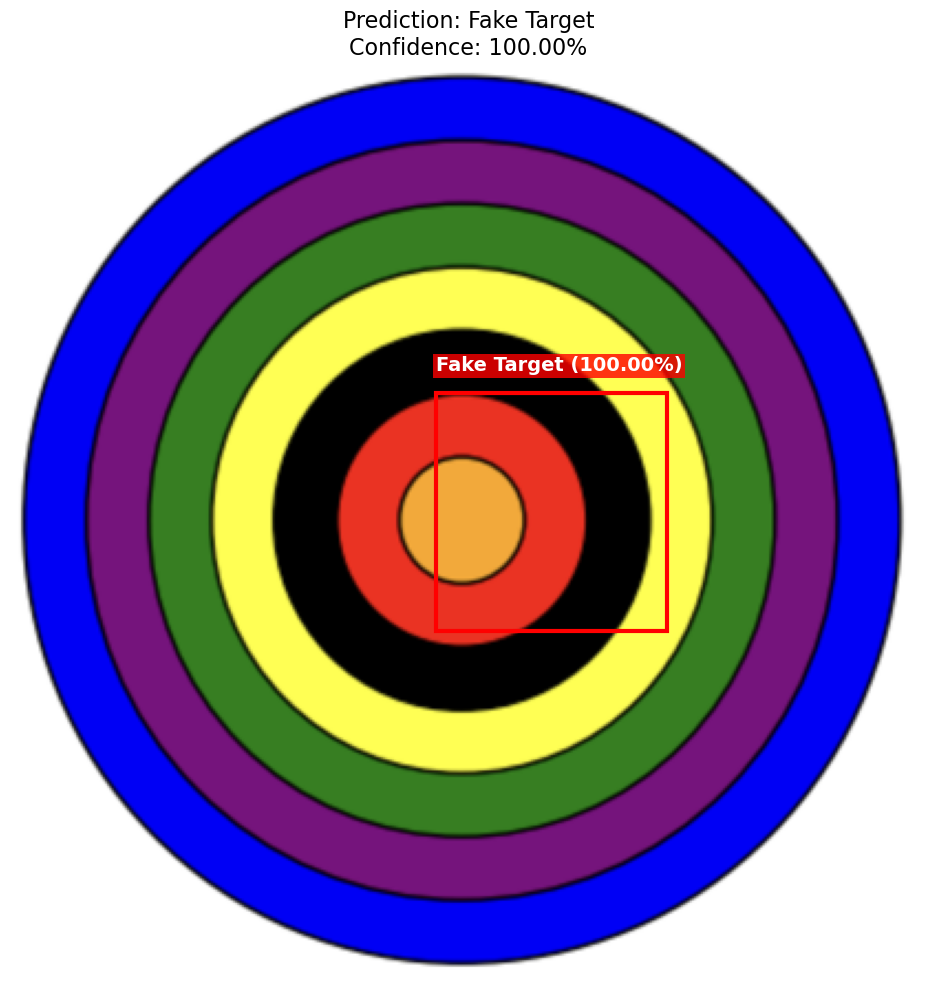

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.17.57 PM.png
Processing 33-3255-m_png_jpg.rf.5503a8dac27e5972020846d85d2c7f0f.jpg...
1/1 [==============================] - 0s 54ms/step


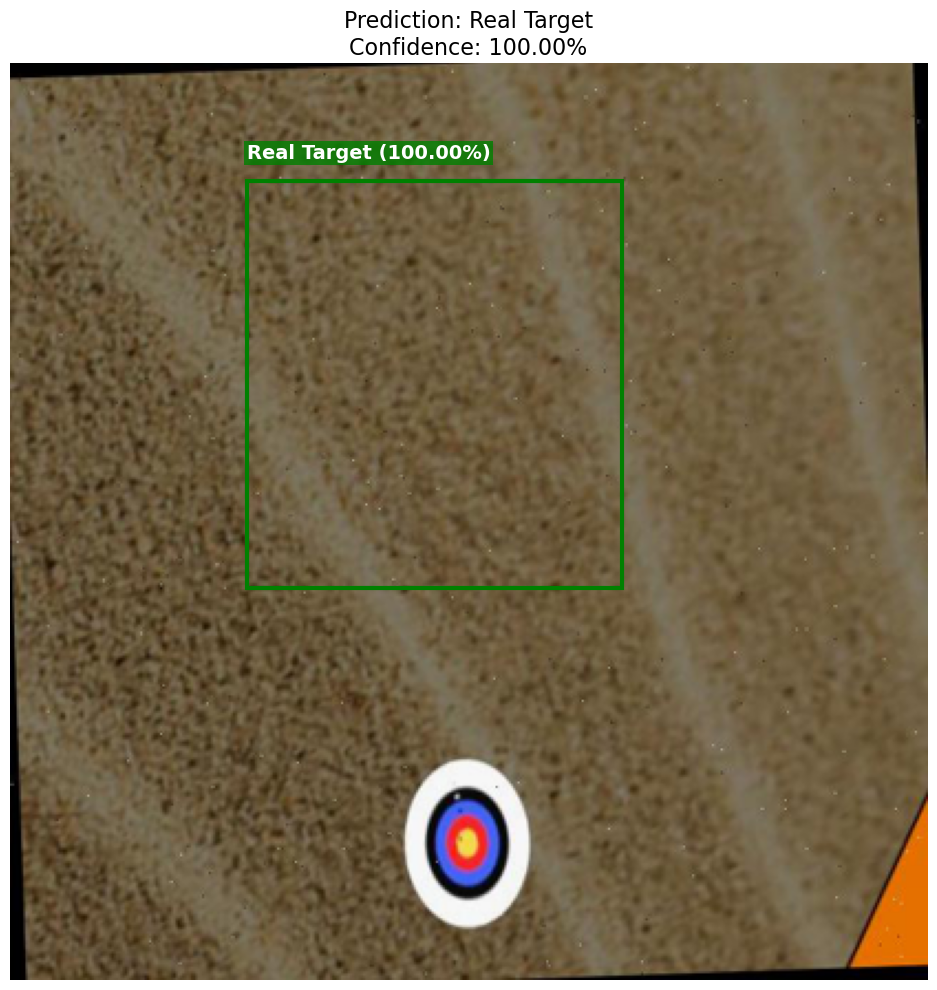

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_33-3255-m_png_jpg.rf.5503a8dac27e5972020846d85d2c7f0f.jpg
Processing Screenshot 2025-01-21 at 7.31.14 PM copy 3.png...
1/1 [==============================] - 0s 53ms/step


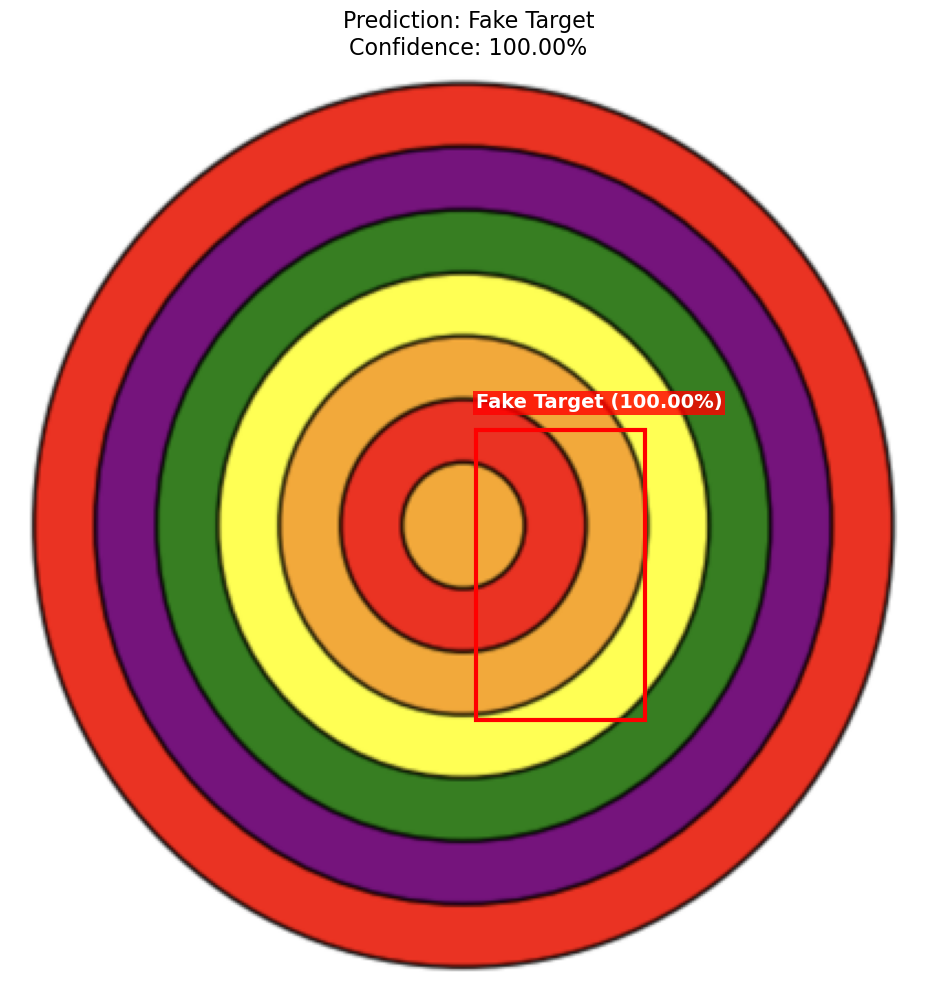

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.31.14 PM copy 3.png
Processing Screenshot 2025-01-21 at 7.31.14 PM copy 2.png...
1/1 [==============================] - 0s 52ms/step


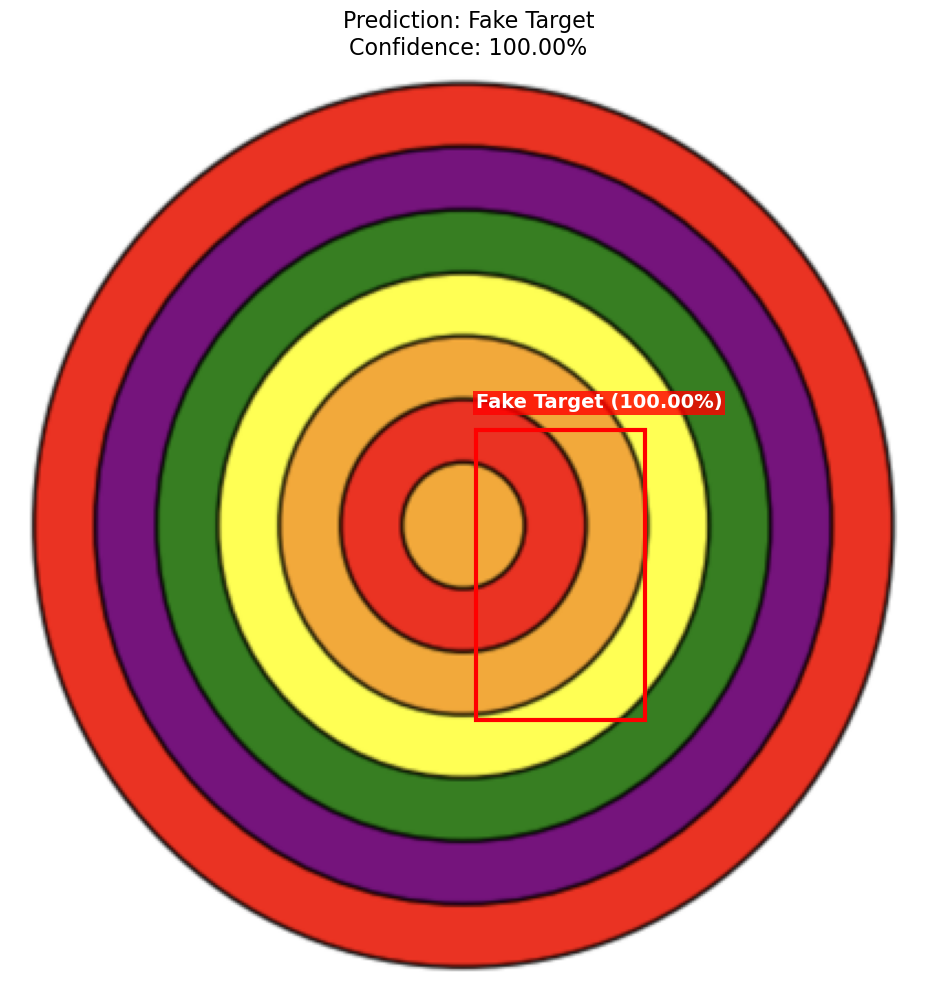

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.31.14 PM copy 2.png
Processing Screenshot 2025-01-21 at 7.16.19 PM copy.png...
1/1 [==============================] - 0s 54ms/step


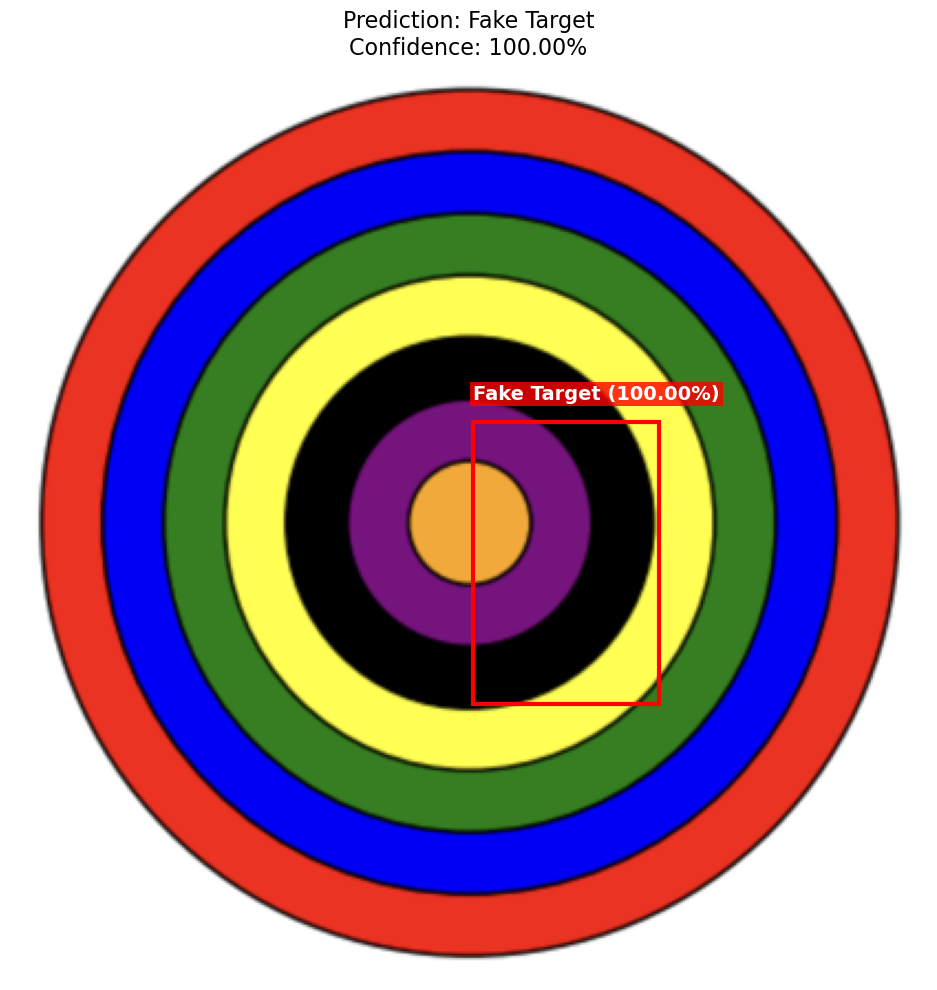

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.16.19 PM copy.png
Processing Screenshot 2025-01-21 at 7.17.57 PM copy.png...
1/1 [==============================] - 0s 50ms/step


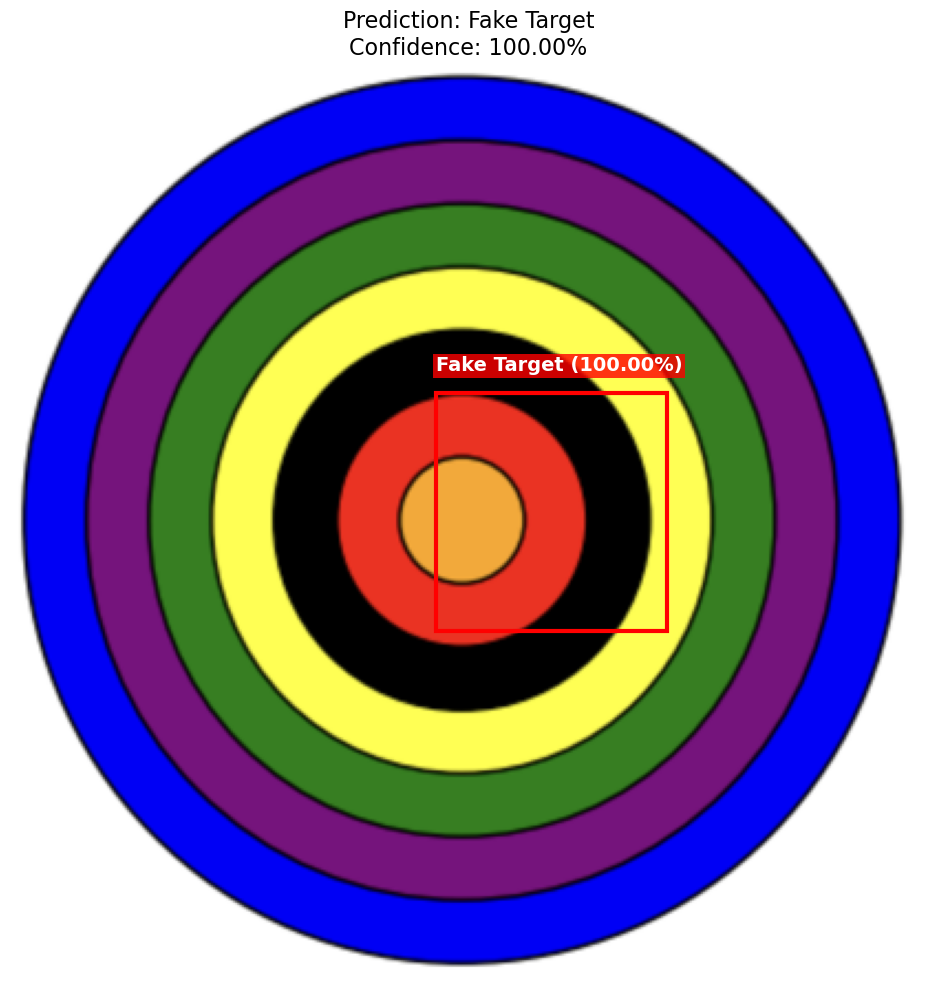

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.17.57 PM copy.png
Processing WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.049457a1dafd55f5cb52c3625926adef.jpg...
1/1 [==============================] - 0s 45ms/step


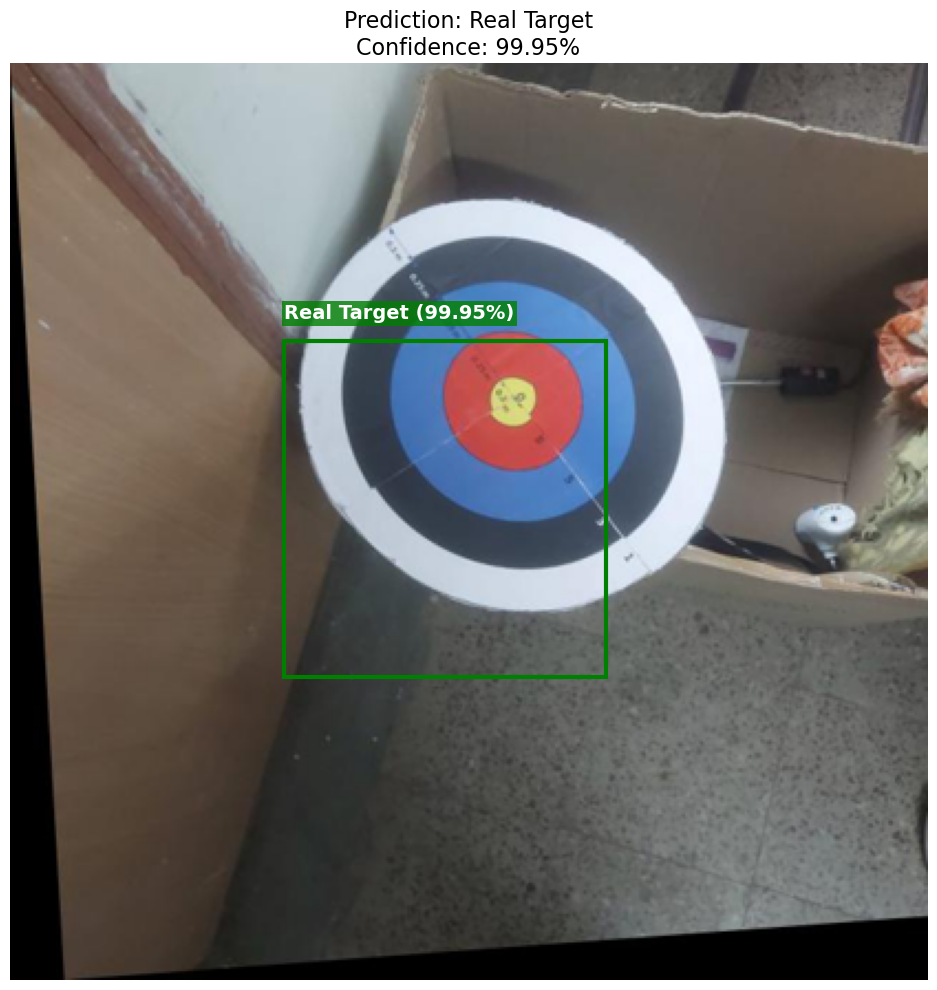

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.049457a1dafd55f5cb52c3625926adef.jpg
Processing Screenshot 2025-01-21 at 7.16.19 PM.png...
1/1 [==============================] - 0s 56ms/step


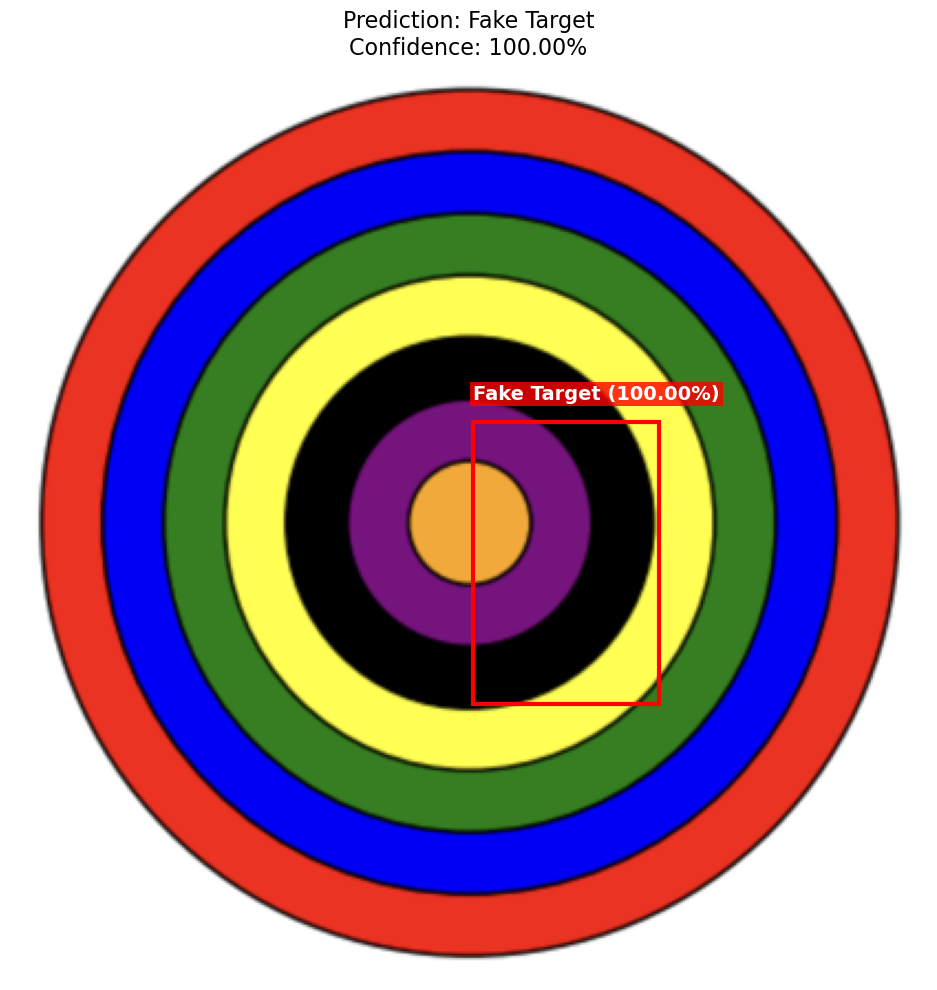

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.16.19 PM.png
Processing 16-7489-m_png_jpg.rf.55aa9bdf517024d6a5dd23722f86b731.jpg...
1/1 [==============================] - 0s 48ms/step


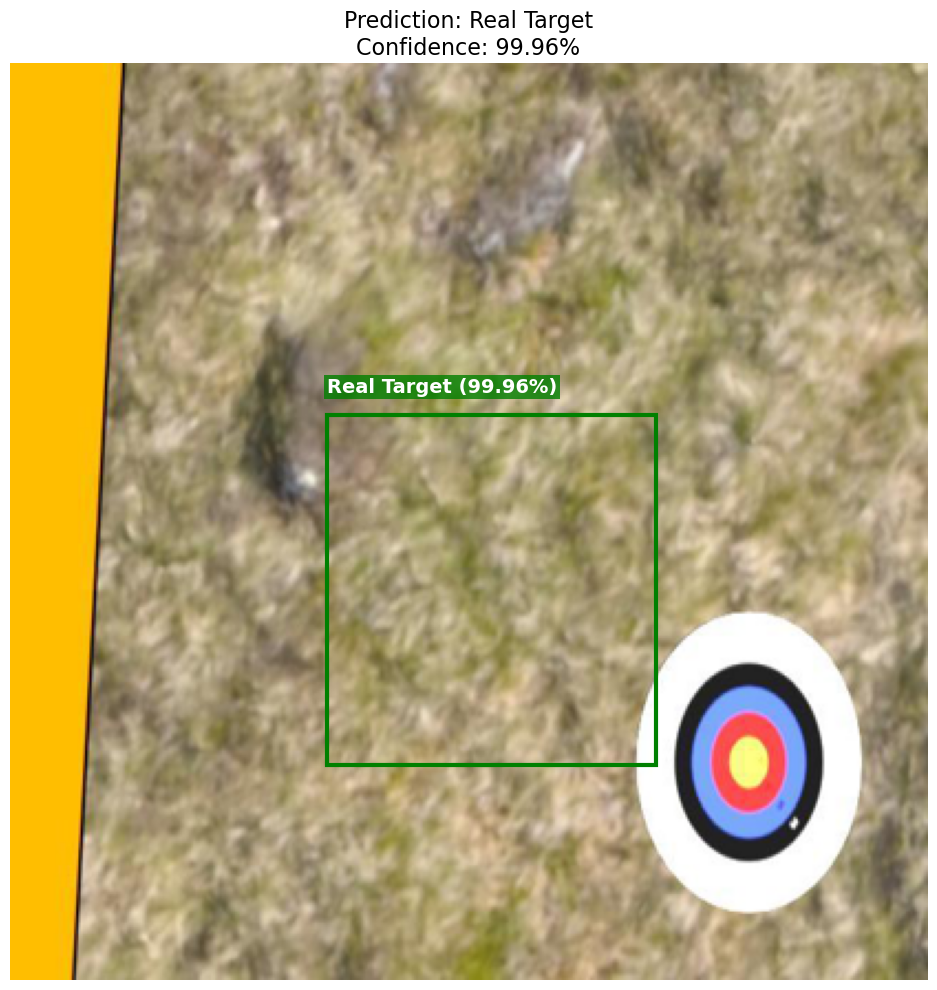

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_16-7489-m_png_jpg.rf.55aa9bdf517024d6a5dd23722f86b731.jpg
Processing 24-7637-m_png_jpg.rf.b1a8c5a9beedc18fd5cac1d9bd6fc2c8.jpg...
1/1 [==============================] - 0s 56ms/step


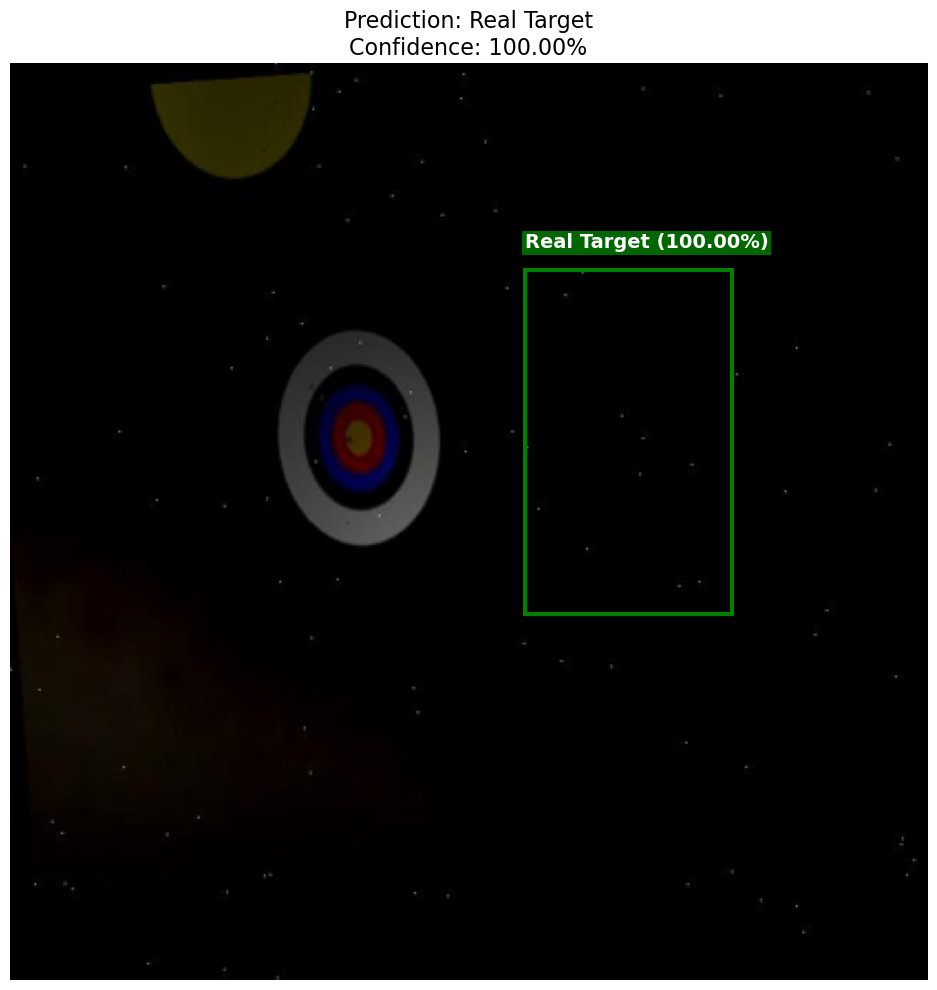

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_24-7637-m_png_jpg.rf.b1a8c5a9beedc18fd5cac1d9bd6fc2c8.jpg
Processing Screenshot 2025-01-21 at 7.16.19 PM copy 2.png...
1/1 [==============================] - 0s 54ms/step


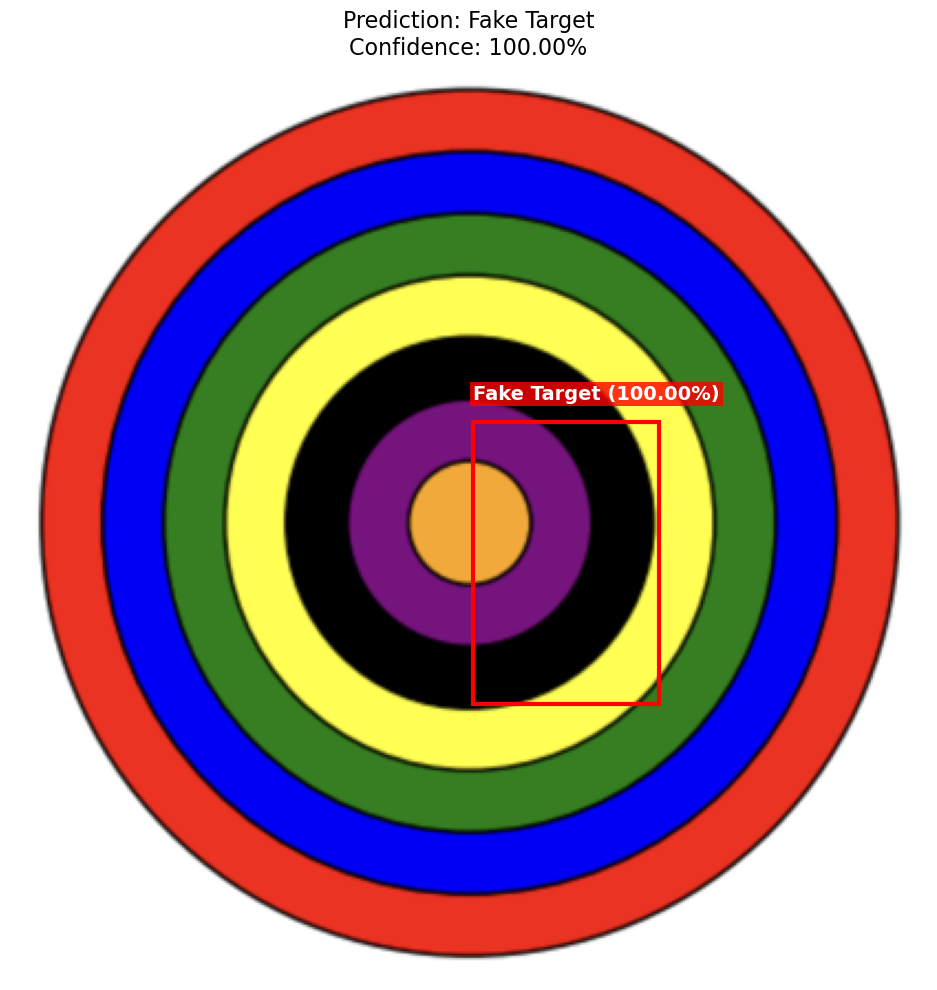

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.16.19 PM copy 2.png
Processing 26-1887-m_png_jpg.rf.53bf0c66ffcb0e832d11135026cc0862.jpg...
1/1 [==============================] - 0s 63ms/step


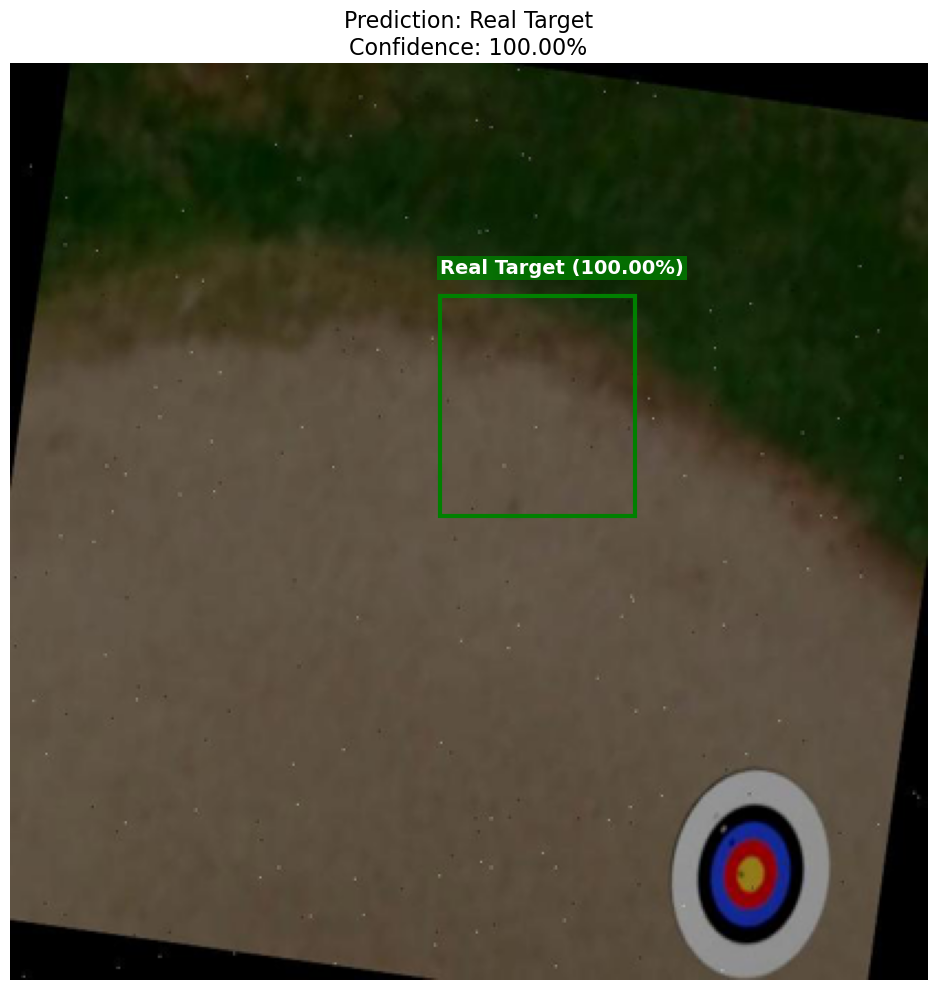

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_26-1887-m_png_jpg.rf.53bf0c66ffcb0e832d11135026cc0862.jpg
Processing WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.e83b8e4fef41131304ab4de65bf911ce.jpg...
1/1 [==============================] - 0s 47ms/step


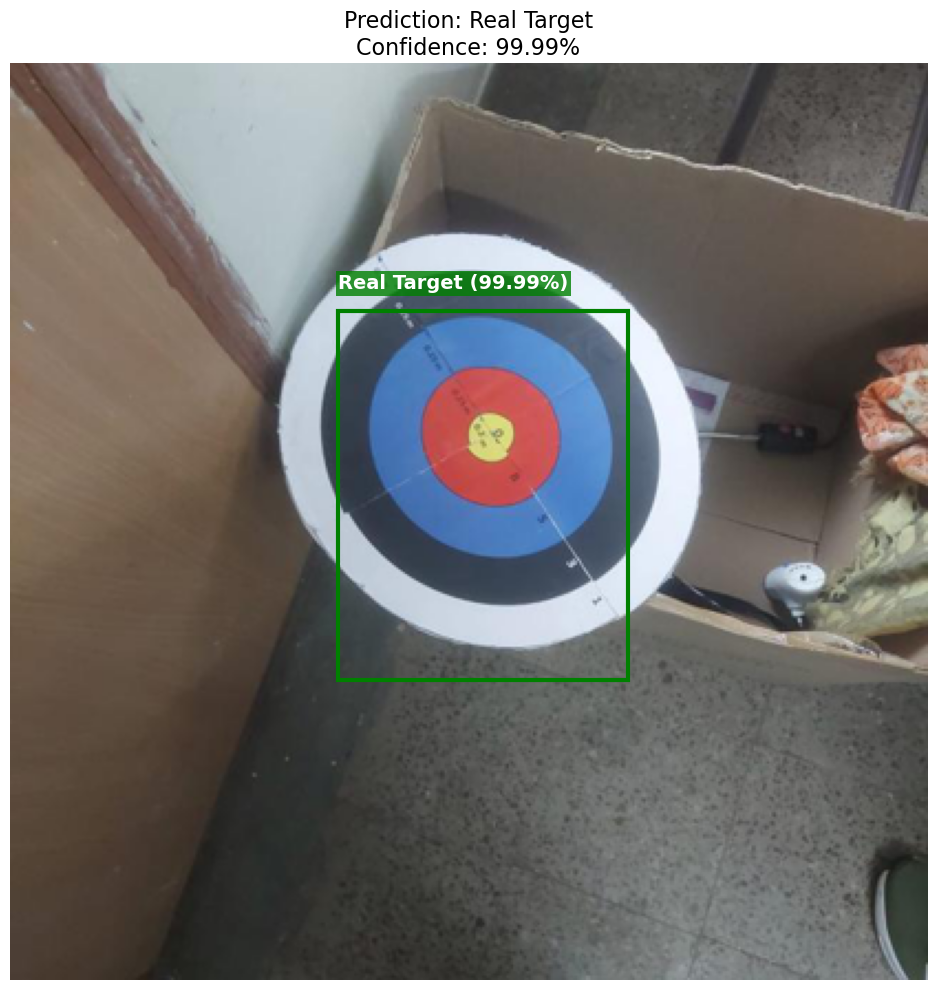

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_WhatsApp-Image-2023-08-18-at-19-32-29_jpeg.rf.e83b8e4fef41131304ab4de65bf911ce.jpg
Processing 32-443-m_png_jpg.rf.985846371218c907dc2433fe3fb79c1c.jpg...
1/1 [==============================] - 0s 54ms/step


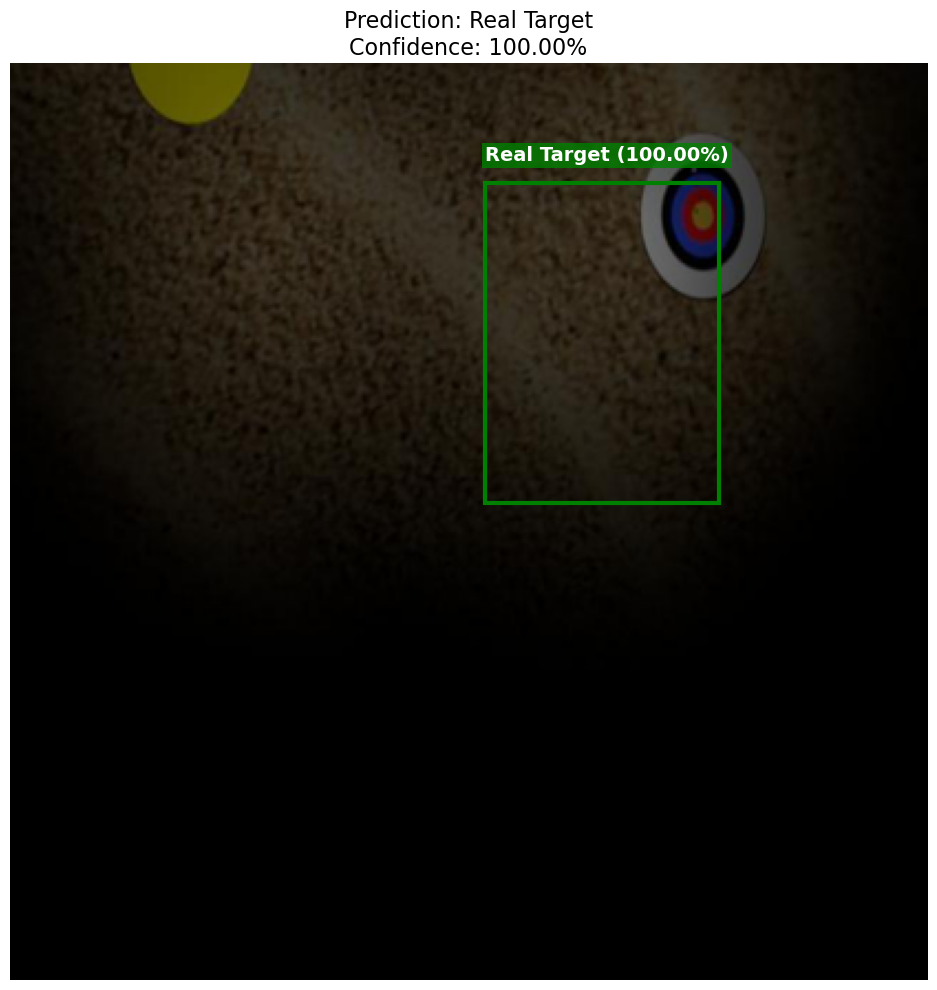

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_32-443-m_png_jpg.rf.985846371218c907dc2433fe3fb79c1c.jpg
Processing Screenshot 2025-01-21 at 7.17.57 PM copy 2.png...
1/1 [==============================] - 0s 103ms/step


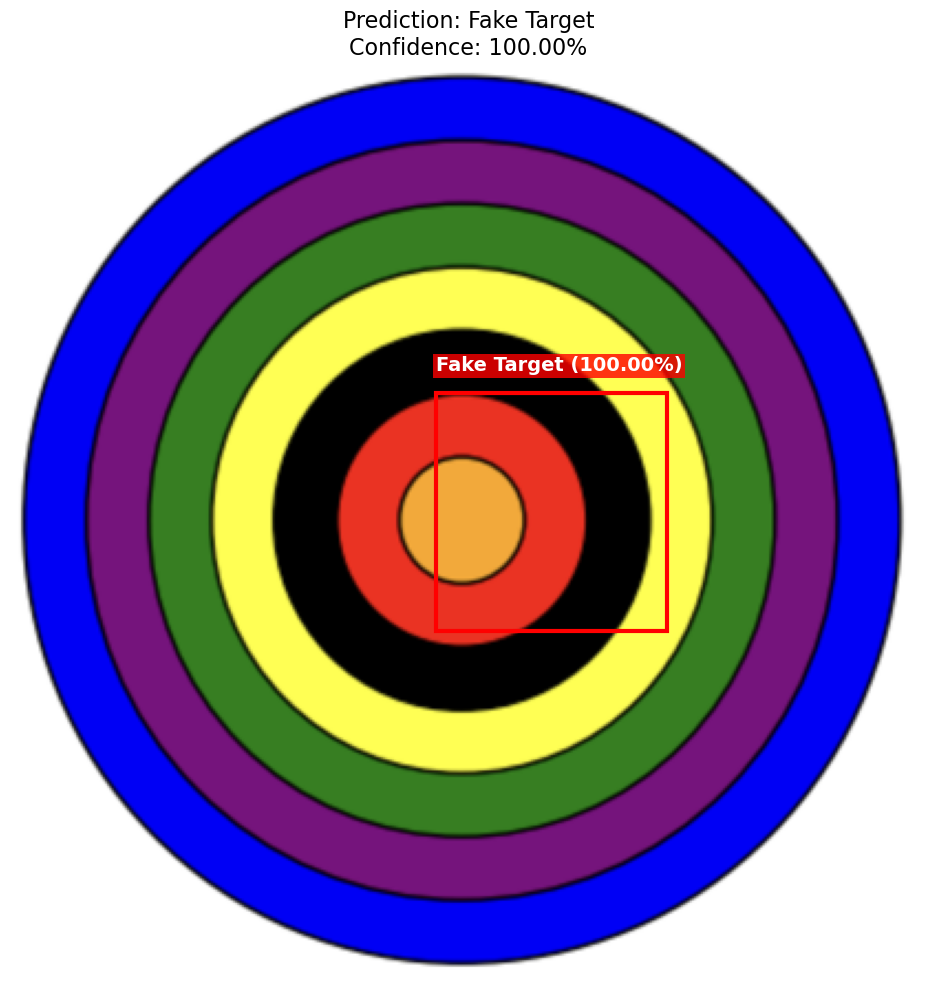

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_Screenshot 2025-01-21 at 7.17.57 PM copy 2.png
Processing 33-3255-m_png_jpg.rf.4f3269f33ea1d9a809a7ef3bff504a01.jpg...
1/1 [==============================] - 0s 60ms/step


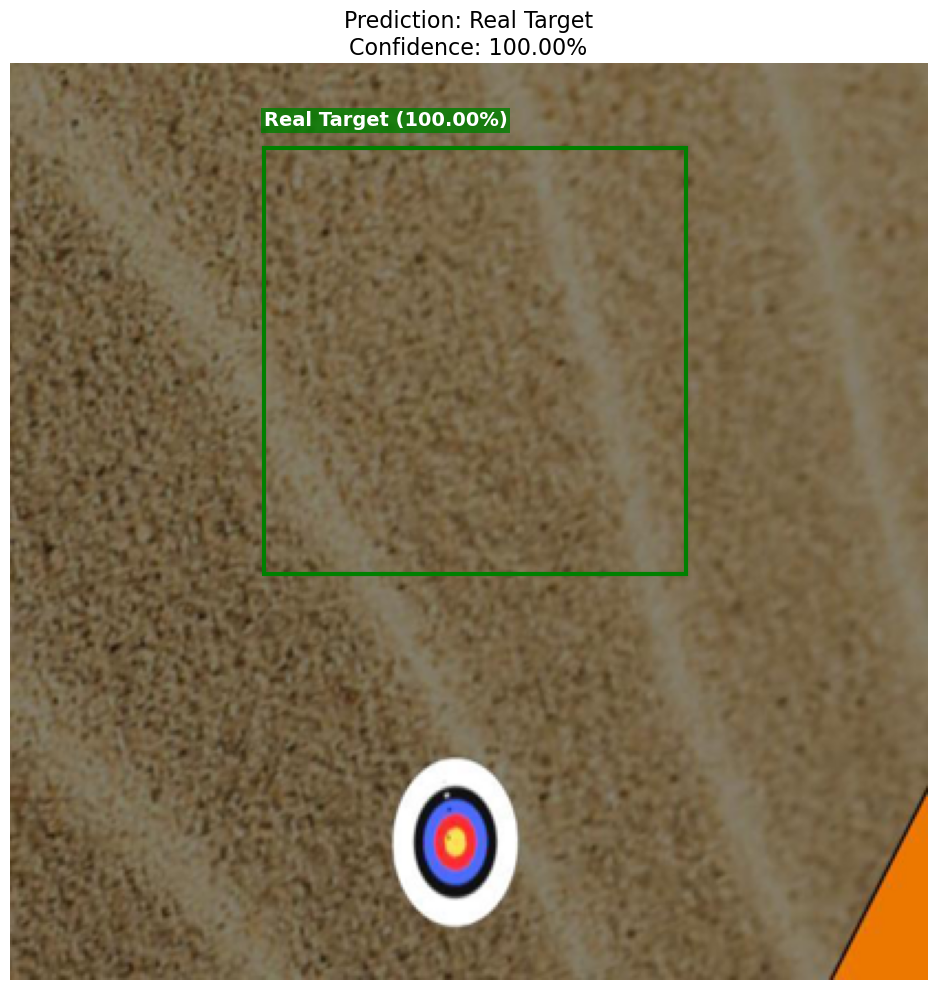

Saved image with bounding box to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/results/detected_33-3255-m_png_jpg.rf.4f3269f33ea1d9a809a7ef3bff504a01.jpg

=== Detection Results ===
Processed 20 images
Real Targets: 11
Fake Targets: 9
Detection report saved to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/detection_report.txt


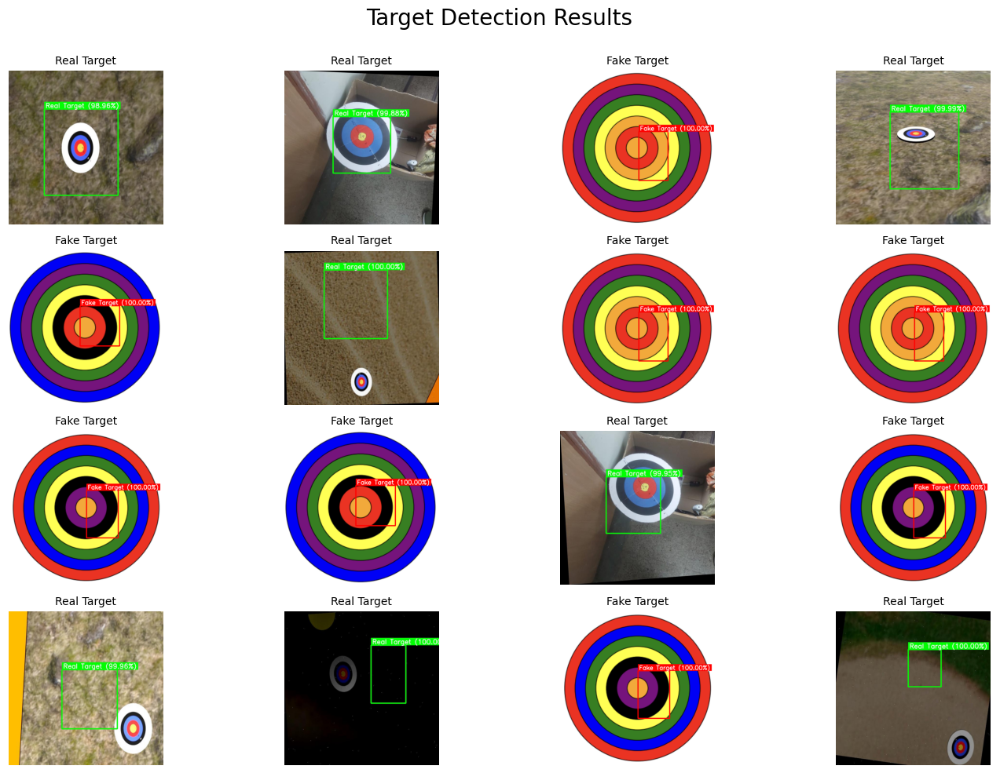

Summary visualization saved to /Users/rohanshenoy/Desktop/Aerothon.v3i.yolokeras/test_images/detection_summary.png

==== Analysis Complete ====


In [7]:
# Modified function to display labels with bounding boxes
def predict_with_bbox(model, image_path):
    """
    Predict class and bounding box for a single image with improved label display
    """
    img = Image.open(image_path).convert("RGB")
    original_img = np.array(img)
    
    # Resize for model input
    img = img.resize((IMG_SIZE, IMG_SIZE))
    img_array = np.array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    
    # Get predictions
    class_pred, bbox_pred = model.predict(img_array)
    
    # Extract prediction values
    is_real = class_pred[0][0] > 0.5
    label = "Real Target" if is_real else "Fake Target"
    confidence = class_pred[0][0] if is_real else 1 - class_pred[0][0]
    
    # Extract bounding box coordinates (center_x, center_y, width, height)
    center_x, center_y, width, height = bbox_pred[0]
    
    # Convert to corner coordinates
    x1 = center_x - width/2
    y1 = center_y - height/2
    x2 = center_x + width/2
    y2 = center_y + height/2
    
    # Plot the image with bounding box
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    
    # Create a Rectangle patch
    rect_color = 'green' if is_real else 'red'
    rect = patches.Rectangle(
        (x1 * IMG_SIZE, y1 * IMG_SIZE),
        width * IMG_SIZE,
        height * IMG_SIZE,
        linewidth=3,
        edgecolor=rect_color,
        facecolor='none'
    )
    
    # Add the patch to the Axes
    plt.gca().add_patch(rect)
    
    # Add label text directly on the image
    label_text = f"{label} ({confidence:.2%})"
    text_x = max(0, x1 * IMG_SIZE)
    text_y = max(20, (y1 * IMG_SIZE) - 10)  # Position label above the box
    
    plt.text(
        text_x, text_y, label_text,
        color='white', fontsize=14, fontweight='bold',
        bbox=dict(facecolor=rect_color, alpha=0.8, edgecolor='none', pad=2)
    )
    
    plt.title(f"Prediction: {label}\nConfidence: {confidence:.2%}", fontsize=16)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    return label, confidence, (x1, y1, x2, y2)

# Improved OpenCV version for saving images with labels
def draw_bbox_on_image(image_path, bbox, is_real, confidence):
    """
    Draw bounding box and label on an image using OpenCV
    """
    img = cv2.imread(image_path)
    h, w, _ = img.shape
    
    # Unpack bbox (normalized values)
    x1, y1, x2, y2 = bbox
    
    # Convert normalized coordinates to pixel values
    x1 = int(x1 * w)
    y1 = int(y1 * h)
    x2 = int(x2 * w)
    y2 = int(y2 * h)
    
    # Draw rectangle
    color = (0, 255, 0) if is_real else (0, 0, 255)  # Green for real, Red for fake
    cv2.rectangle(img, (x1, y1), (x2, y2), color, 3)
    
    # Add label with confidence
    label = f"{'Real Target' if is_real else 'Fake Target'} ({confidence:.2%})"
    
    # Calculate text size to create background box
    text_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.9, 2)[0]
    
    # Create background rectangle for text
    cv2.rectangle(
        img, 
        (x1, y1 - text_size[1] - 10), 
        (x1 + text_size[0] + 10, y1), 
        color, 
        -1
    )
    
    # Add text
    cv2.putText(
        img, 
        label, 
        (x1 + 5, y1 - 5), 
        cv2.FONT_HERSHEY_SIMPLEX, 
        0.9, 
        (255, 255, 255), 
        2
    )
    
    # Display the image
    cv2.imshow('Detection', img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    
    # Save the image with bounding box
    base_name = os.path.basename(image_path)
    output_dir = os.path.join(os.path.dirname(image_path), 'results')
    os.makedirs(output_dir, exist_ok=True)
    output_path = os.path.join(output_dir, f"detected_{base_name}")
    cv2.imwrite(output_path, img)
    print(f"Saved image with bounding box to {output_path}")
    
    return output_path

# Updated function to process images in a directory
def process_directory_with_bbox(model, directory_path):
    """
    Process all images in a directory and draw bounding boxes with labels
    """
    results = []
    
    for img_name in os.listdir(directory_path):
        if img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
            img_path = os.path.join(directory_path, img_name)
            print(f"Processing {img_name}...")
            
            # Get predictions
            label, confidence, bbox = predict_with_bbox(model, img_path)
            
            # Draw bbox on image using OpenCV and save
            is_real = label == "Real Target"
            output_path = draw_bbox_on_image(img_path, bbox, is_real, confidence)
            
            # Store results
            results.append({
                'image': img_name,
                'prediction': label,
                'confidence': confidence,
                'bbox': bbox,
                'output_path': output_path
            })
    
    # Display summary
    print("\n=== Detection Results ===")
    print(f"Processed {len(results)} images")
    real_count = sum(1 for r in results if r['prediction'] == "Real Target")
    fake_count = len(results) - real_count
    print(f"Real Targets: {real_count}")
    print(f"Fake Targets: {fake_count}")
    
    return results

# The function to run batch predictions on a directory and generate a report
def generate_detection_report(model, directory_path):
    """
    Generate a comprehensive detection report for a directory of images
    """
    results = process_directory_with_bbox(model, directory_path)
    
    # Create a more detailed report
    report_path = os.path.join(directory_path, 'detection_report.txt')
    with open(report_path, 'w') as f:
        f.write("=== Target Detection Report ===\n\n")
        f.write(f"Total images processed: {len(results)}\n")
        f.write(f"Real Targets: {sum(1 for r in results if r['prediction'] == 'Real Target')}\n")
        f.write(f"Fake Targets: {sum(1 for r in results if r['prediction'] == 'Fake Target')}\n\n")
        
        f.write("Individual Results:\n")
        f.write("-" * 80 + "\n")
        for r in results:
            f.write(f"Image: {r['image']}\n")
            f.write(f"Prediction: {r['prediction']}\n")
            f.write(f"Confidence: {r['confidence']:.2%}\n")
            f.write(f"Bounding Box (normalized): {r['bbox']}\n")
            f.write(f"Output Image: {r['output_path']}\n")
            f.write("-" * 80 + "\n")
    
    print(f"Detection report saved to {report_path}")
    
    # Generate a visualization of all results
    plt.figure(figsize=(15, 10))
    plt.suptitle("Target Detection Results", fontsize=20)
    
    for i, r in enumerate(results[:min(16, len(results))]):  # Display up to 16 images
        plt.subplot(4, 4, i+1)
        img = plt.imread(r['output_path'])
        plt.imshow(img)
        plt.title(f"{r['prediction']}", fontsize=10)
        plt.axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    
    # Save the visualization
    vis_path = os.path.join(directory_path, 'detection_summary.png')
    plt.savefig(vis_path, dpi=300)
    plt.show()
    print(f"Summary visualization saved to {vis_path}")

# Make sure to update the main execution to use this new report generation function
if __name__ == "__main__":
    # Train the bounding box model
    print("Training bounding box detection model...")
    model, history, X_test, y_class_test, y_bbox_test = train_bbox_model()
    
    print("Evaluating model...")
    evaluate_bbox_model(model, X_test, y_class_test, y_bbox_test)
    
    print("Analyzing model fit...")
    analyze_model_fit(history, model, X_test, y_class_test, y_bbox_test)
    
    print("Saving model...")
    model.save('target_detection_bbox_model.h5')
    
    # Save history for future analysis
    import pickle
    with open('training_history.pkl', 'wb') as f:
        pickle.dump(history, f)
    
    print("Testing on sample images...")
    test_dir = os.path.join(BASE_PATH, 'test_images')
    if os.path.exists(test_dir):
        # Use the new report generation function
        generate_detection_report(model, test_dir)
    else:
        print(f"Test directory {test_dir} not found. Please create it and add test images.")
        
    print("\n==== Analysis Complete ====")